In [1]:
%matplotlib inline
import sys
sys.path.insert(1, '../../../script/')

In [39]:
import math
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
#import missingno as msno
from scipy.stats import mode
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from collections import defaultdict
from scipy.stats.stats import pearsonr

In [40]:
import cleaning as cl
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [41]:
df = pd.read_csv('../../data/training.csv') 

In [42]:
cl.cleaning(df)

# Analysing the data

So here I plot the graphics for all the three variables to see if it is possible to create clusters which will contain only good and only bad buys (approximately).
From the plots we can see that there are some tendencies (for example, on the first plot, where we see WarrantyCost and MMRAcquisitionAuctionAveragePrice, if the WarrantyCost is really small there is a high possibility that the acquisition was a bad buy), but I can't clearly see any possible clusters. So from the begining we must understand that these three variables are not enough to distinguish good buy from the bad buy.

If you ask me, in this Clustering section of our paper we should provide the different clusters (for k-means, density and hierarchical) and at the end say that none of them are perfect and they give only really rough approximation of bad or good buy. This demonstrates that unsupervised classification doesn't give good enough result with our dataset, so we must move towards supervised approaches (where other than numerical values we can use categorical ones, and they might give us the distinguish factors)

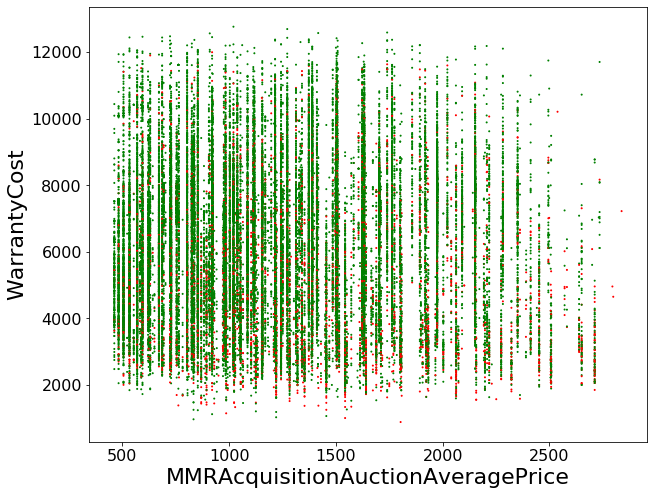

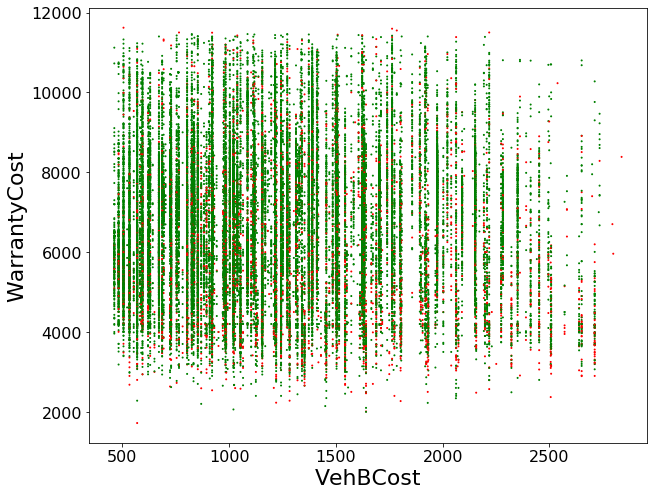

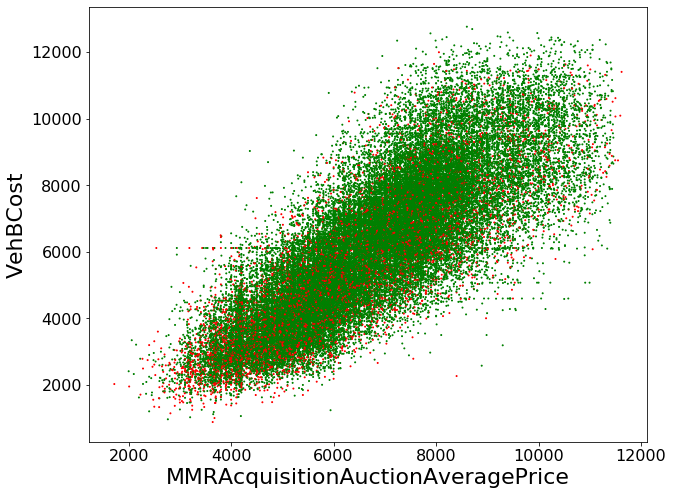

In [6]:
LABEL_COLOR_MAP = {0 : 'g',
                   1 : 'r'
                   }
clusters = c=df['IsBadBuy']
clusters = [LABEL_COLOR_MAP[l] for l in clusters]

plt.figure(figsize=(10, 8))
plt.scatter(df['WarrantyCost'], df['MMRAcquisitionAuctionAveragePrice'], c=clusters, s=1)
plt.tick_params(axis='both', which='major', labelsize=16)
plt.ylabel('WarrantyCost', fontsize=22)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=22)
plt.show()

plt.figure(figsize=(10, 8))
plt.scatter(df['WarrantyCost'], df['VehBCost'], c=clusters, s=1)
plt.tick_params(axis='both', which='major', labelsize=16)
plt.ylabel('WarrantyCost', fontsize=22)
plt.xlabel('VehBCost', fontsize=22)
plt.show()

plt.figure(figsize=(10, 8))
plt.scatter(df['VehBCost'], df['MMRAcquisitionAuctionAveragePrice'], c=clusters, s=1)
plt.tick_params(axis='both', which='major', labelsize=16)
plt.ylabel('VehBCost', fontsize=22)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=22)
plt.show()

# Graphics with WarrantyCost, MMRAcquisitionAuctionAveragePrice and VehBCost

In [43]:
X = df[["VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"]]

#scaler = StandardScaler()
scaler = MinMaxScaler()
scaler.fit(X)
X = scaler.transform(X)

<b>Graphic of quality of clustering with the change of K</b>

In [55]:
sse_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    sse = kmeans.inertia_
    sse_list.append(sse)

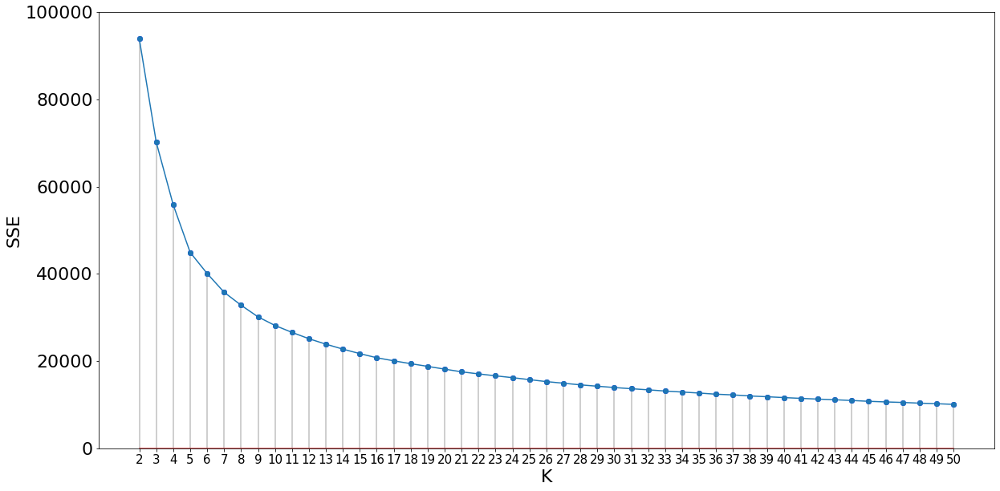

In [56]:
plt.figure(figsize=(20,10))
plt.ylim(0, 100000)
plt.plot(range(2, len(sse_list) + 2), sse_list)
plt.plot(range(2, len(sse_list) + 2), sse_list, 'bo')
plt.stem(range(2, len(sse_list) + 2), sse_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('SSE', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

About the sihoiette from the scikit-learn library: "Silhouette analysis can be used to study the separation distance between the resulting clusters. The silhouette plot displays a measure of how close each point in one cluster is to points in the neighboring clusters and thus provides a way to assess parameters like number of clusters visually. This measure has a range of [-1, 1]. Silhouette coefficients (as these values are referred to as) near +1 indicate that the sample is far away from the neighboring clusters. A value of 0 indicates that the sample is on or very close to the decision boundary between two neighboring clusters and negative values indicate that those samples might have been assigned to the wrong cluster."

So the bigger is the silhouette - more space there is between clusters. So judging by the plot I have decided that K bigger than 8 doesn't have any sence (silhouette is already too small in our dataset (it was expected given the plots we have, because visually there is only one cluster), but I think it is better to have as big distance between the clusters as possible)

In [79]:
silhouette_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    silhouette = silhouette_score(X, kmeans.labels_)
    silhouette_list.append(silhouette)

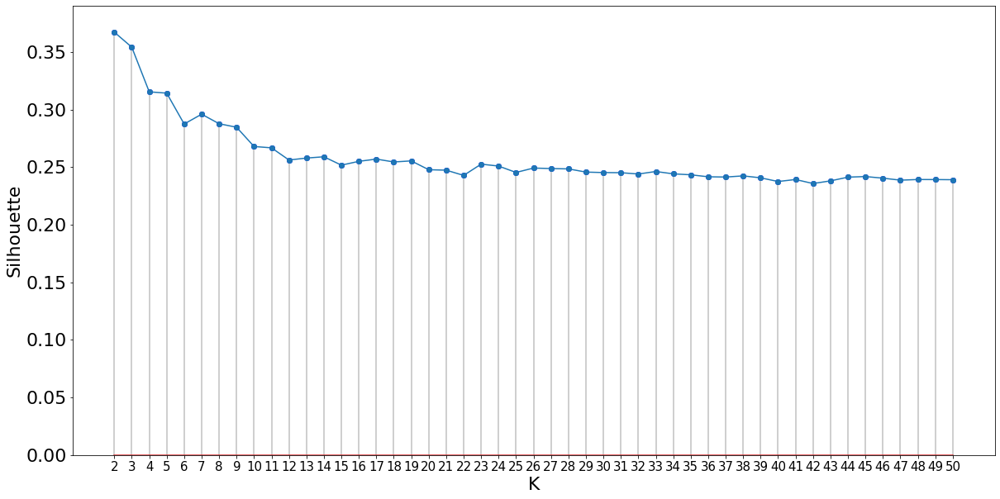

In [82]:
plt.figure(figsize=(20,10))
plt.ylim(0, 0.39)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list, 'bo')
plt.stem(range(2, len(silhouette_list) + 2), silhouette_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('Silhouette', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

<b>K-means (2 clusters)</b>

In [48]:
num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, n_init=500, max_iter=500)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

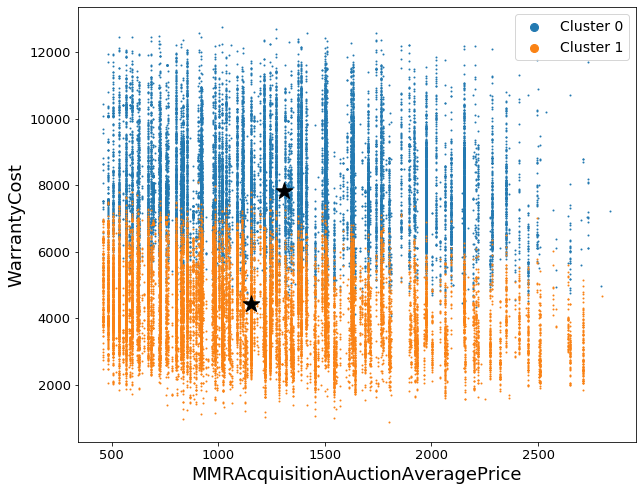

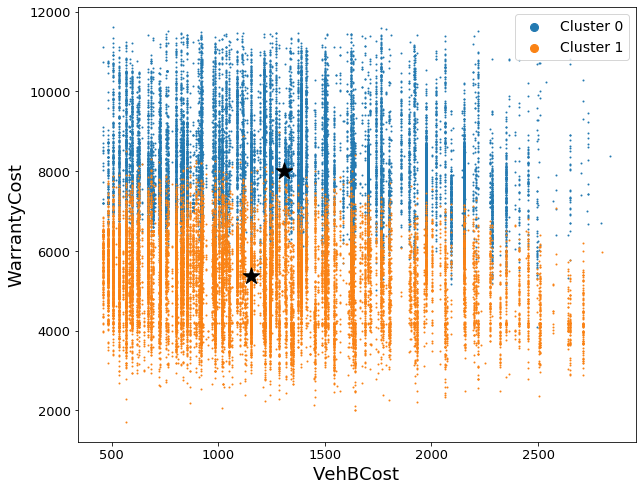

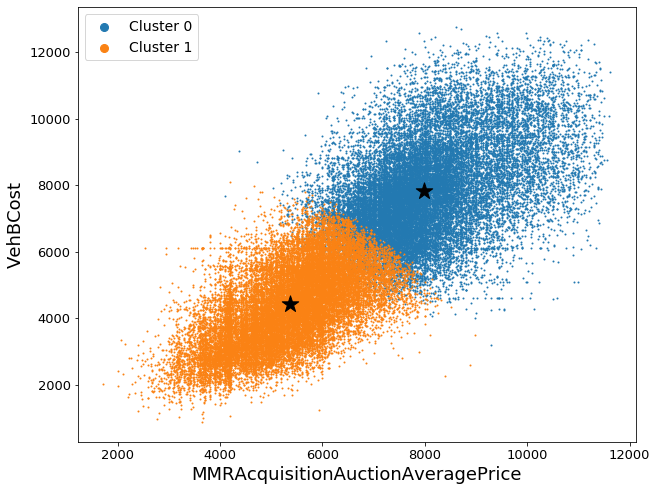

In [49]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 0], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

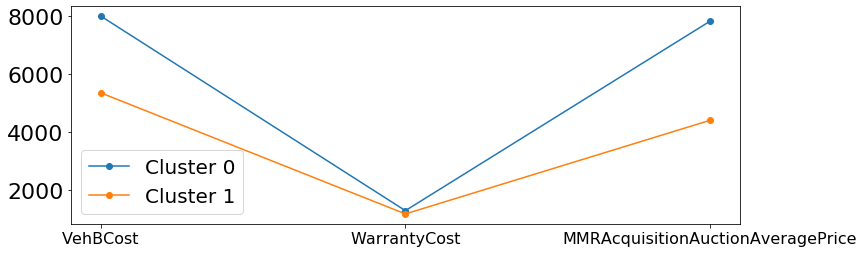

In [19]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(3), ("VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [20]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 93900.0265589782
Silhouette 0.36724382800549704


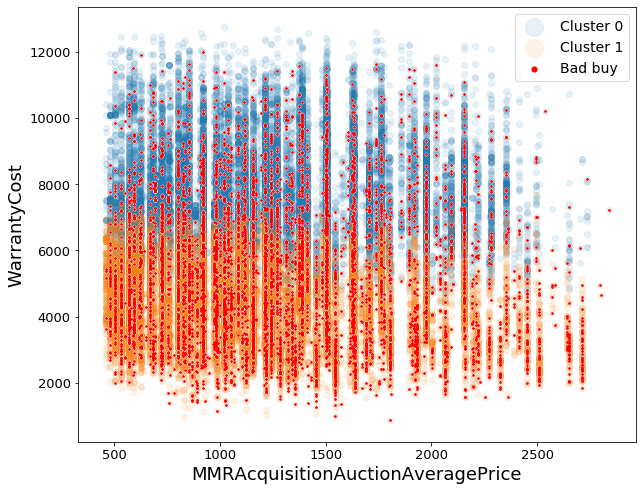

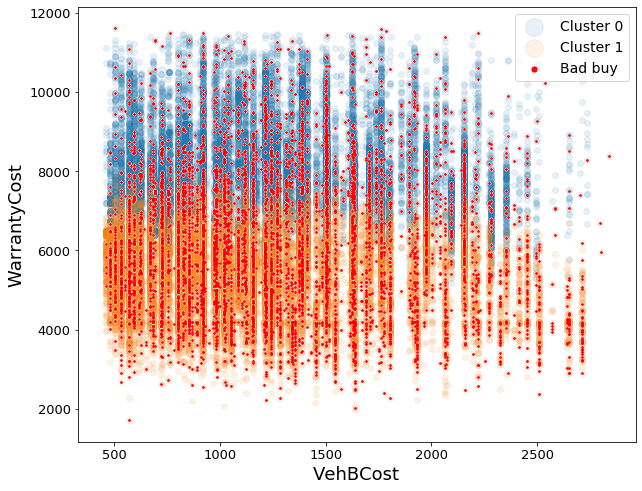

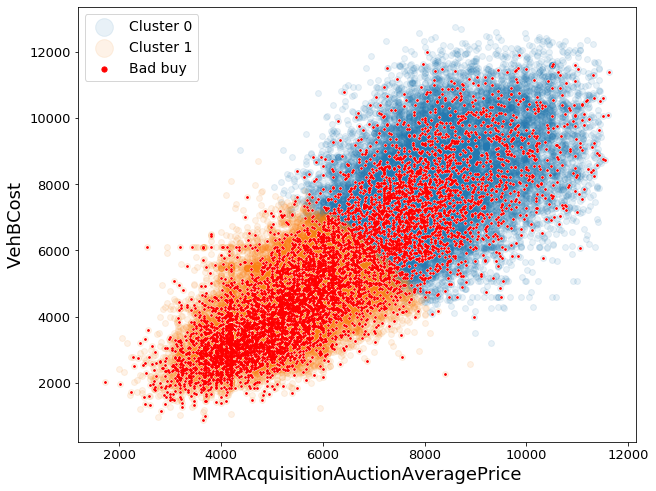

In [21]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [24]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 28416 points
In details: 25947 good buys, and 2469 bad buys
So 8.69% of all the points of the cluster 0 are bad buys
This 2469 bad buys are 37.25% of all bad buys in the dataset

Cluster 1 has in total 26053 points
In details: 21894 good buys, and 4159 bad buys
So 15.96% of all the points of the cluster 1 are bad buys
This 4159 bad buys are 62.75% of all bad buys in the dataset



<b>K-means (3 clusters)</b>

In [52]:
num_clusters = 3
kmeans = KMeans(n_clusters=num_clusters, n_init=500, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

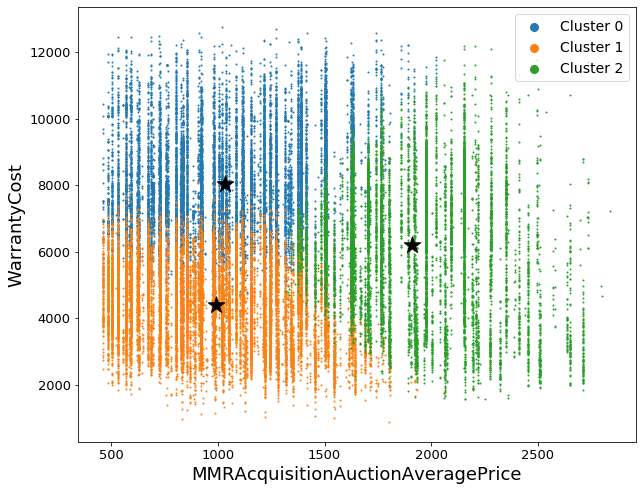

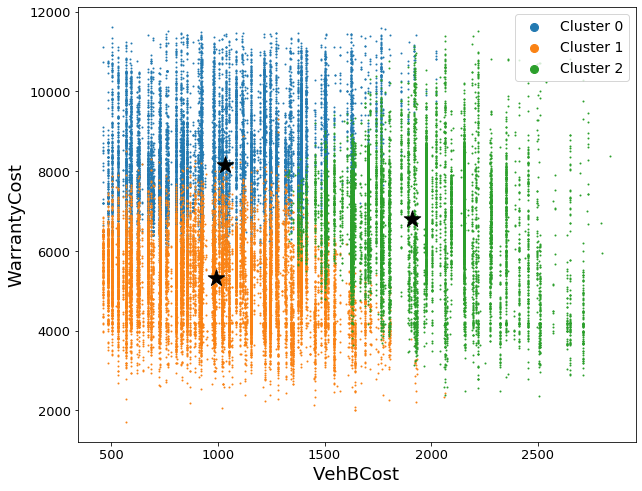

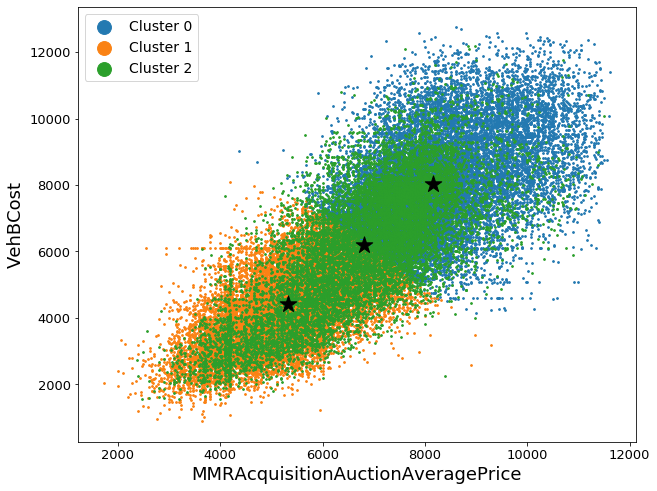

In [54]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 0], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=3, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

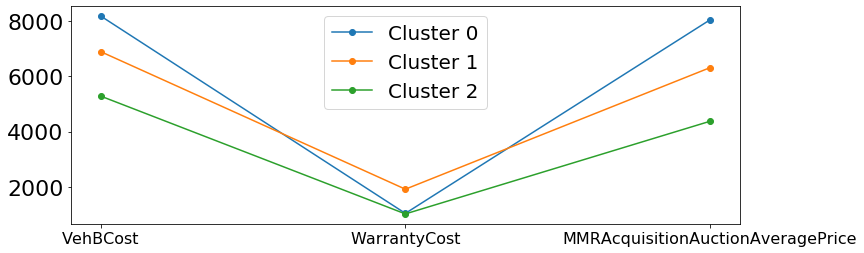

In [27]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(3), ("VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [28]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 70182.84749812378
Silhouette 0.35430777217922627


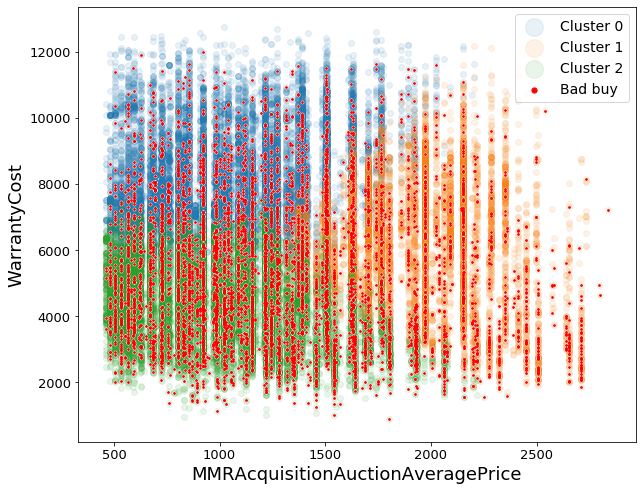

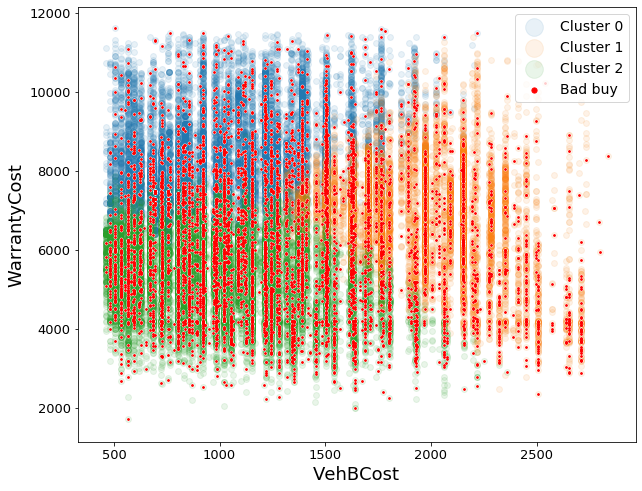

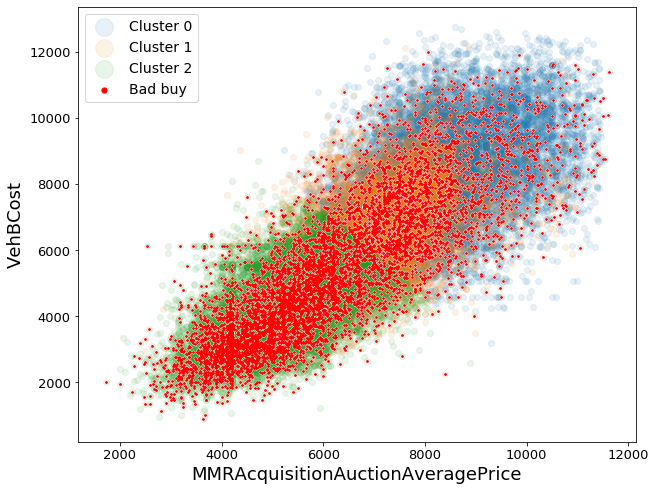

In [29]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [30]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 20355 points
In details: 18600 good buys, and 1755 bad buys
So 8.62% of all the points of the cluster 0 are bad buys
This 1755 bad buys are 26.48% of all bad buys in the dataset

Cluster 1 has in total 12331 points
In details: 10810 good buys, and 1521 bad buys
So 12.33% of all the points of the cluster 1 are bad buys
This 1521 bad buys are 22.95% of all bad buys in the dataset

Cluster 2 has in total 21783 points
In details: 18431 good buys, and 3352 bad buys
So 15.39% of all the points of the cluster 2 are bad buys
This 3352 bad buys are 50.57% of all bad buys in the dataset



<b>K-means (4 clusters)</b>

In [46]:
num_clusters = 4
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=500)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

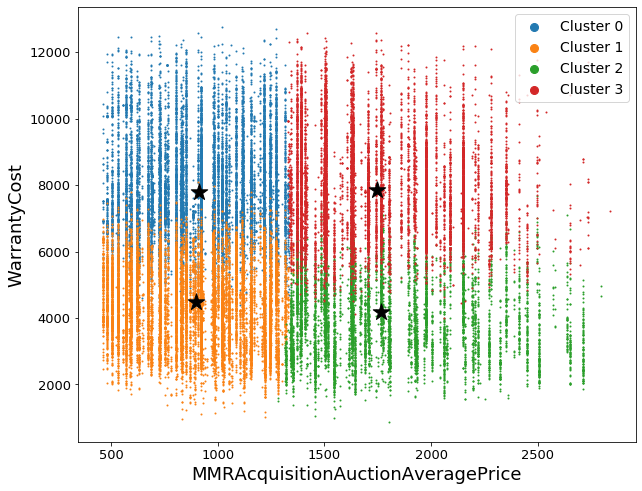

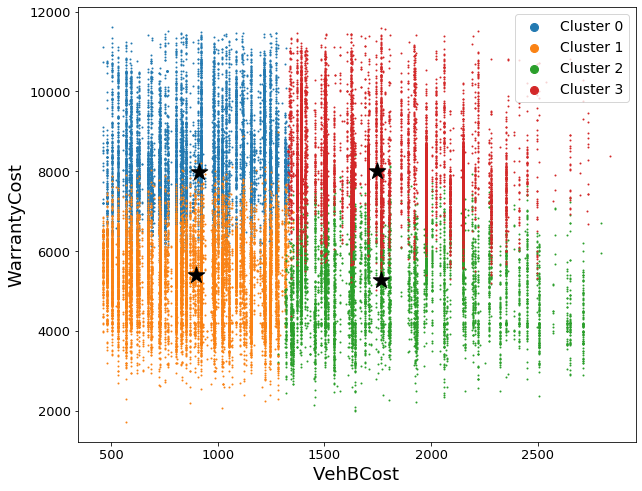

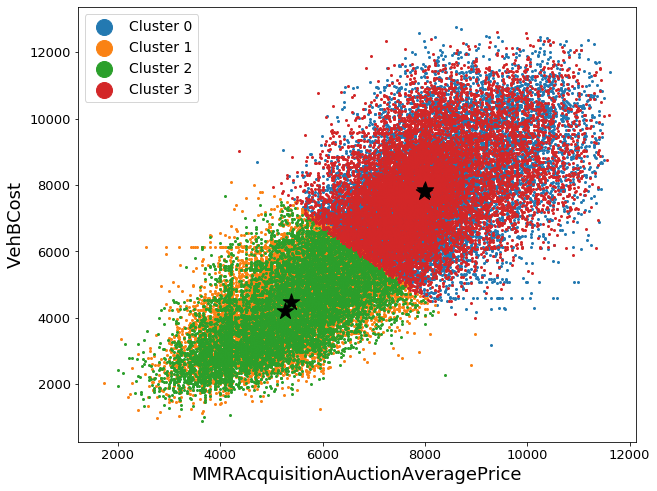

In [47]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 0], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=4, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

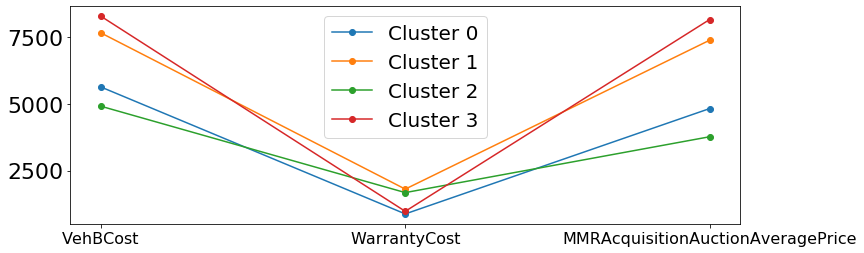

In [33]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(3), ("VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [34]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 55837.91659195113
Silhouette 0.31559220726862386


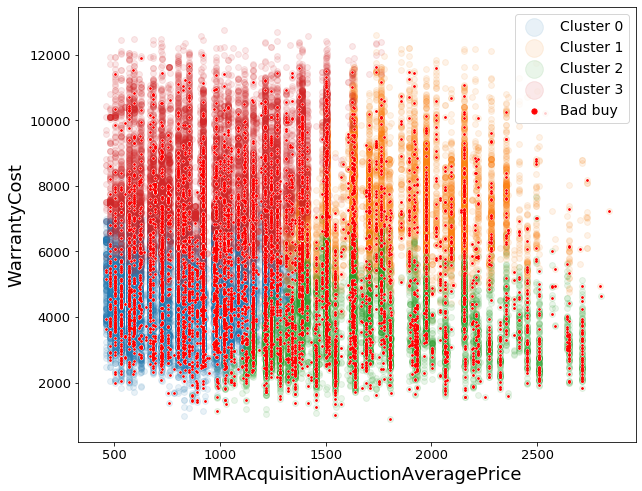

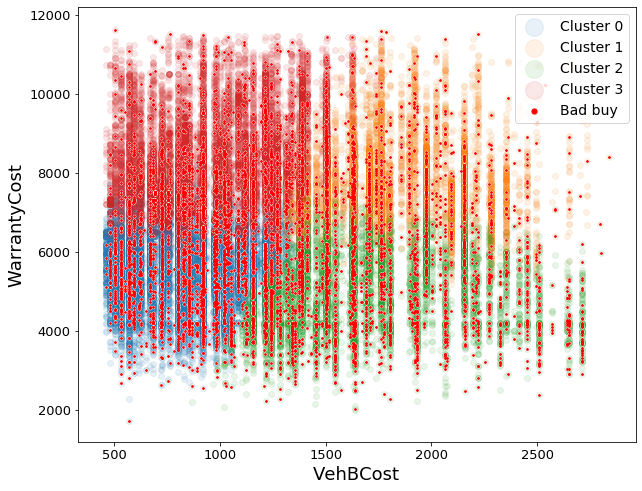

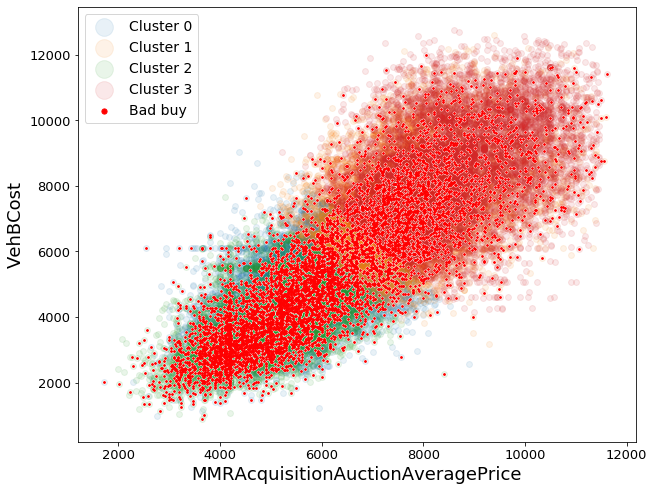

In [35]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [36]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 18023 points
In details: 15740 good buys, and 2283 bad buys
So 12.67% of all the points of the cluster 0 are bad buys
This 2283 bad buys are 34.44% of all bad buys in the dataset

Cluster 1 has in total 11652 points
In details: 10559 good buys, and 1093 bad buys
So 9.38% of all the points of the cluster 1 are bad buys
This 1093 bad buys are 16.49% of all bad buys in the dataset

Cluster 2 has in total 8722 points
In details: 6825 good buys, and 1897 bad buys
So 21.75% of all the points of the cluster 2 are bad buys
This 1897 bad buys are 28.62% of all bad buys in the dataset

Cluster 3 has in total 16072 points
In details: 14717 good buys, and 1355 bad buys
So 8.43% of all the points of the cluster 3 are bad buys
This 1355 bad buys are 20.44% of all bad buys in the dataset



<b>K-means (5 clusters)</b>

In [50]:
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, n_init=500, max_iter=500)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

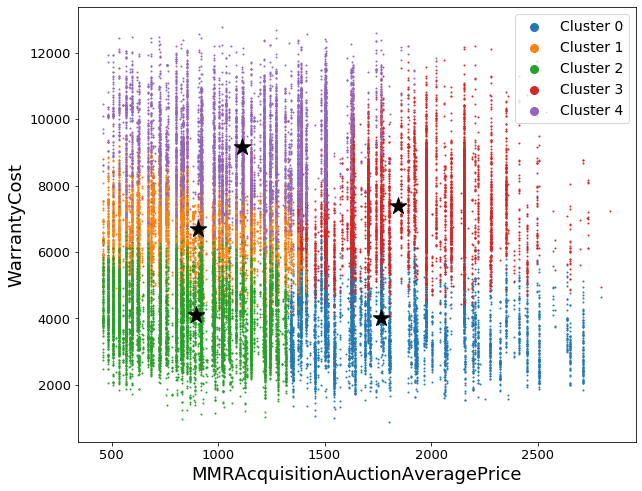

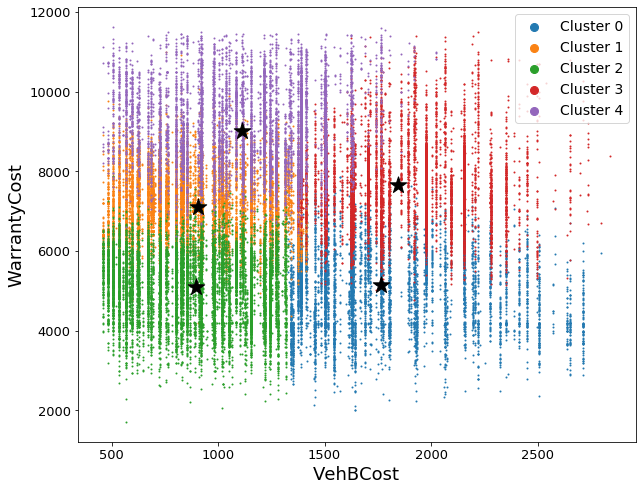

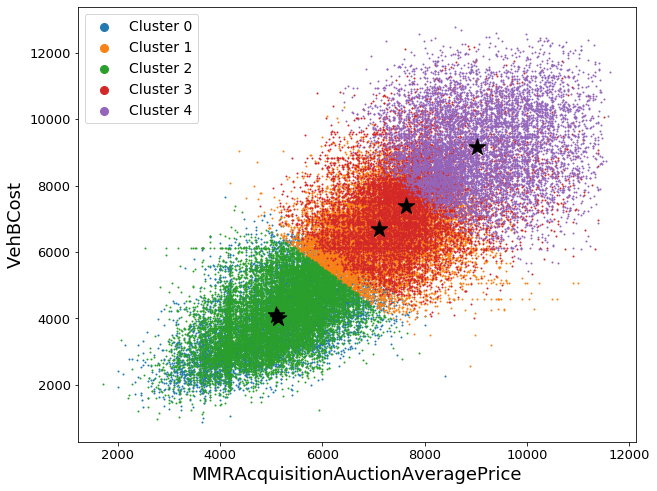

In [51]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 0], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

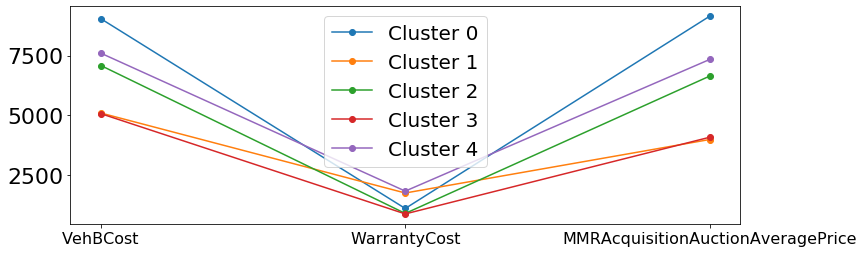

In [39]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(3), ("VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [40]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 44921.90592429359
Silhouette 0.31428691991285523


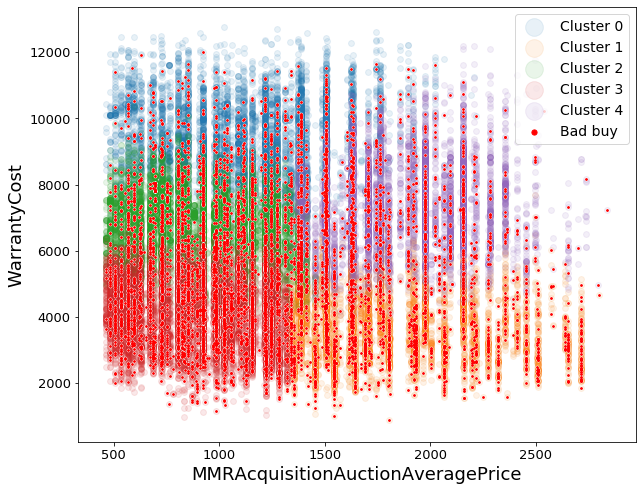

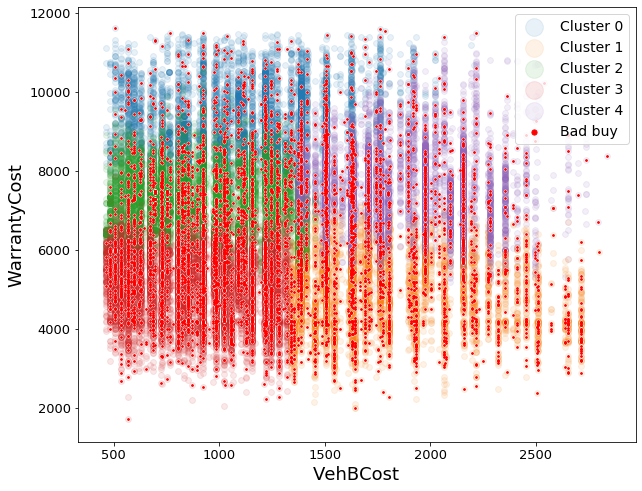

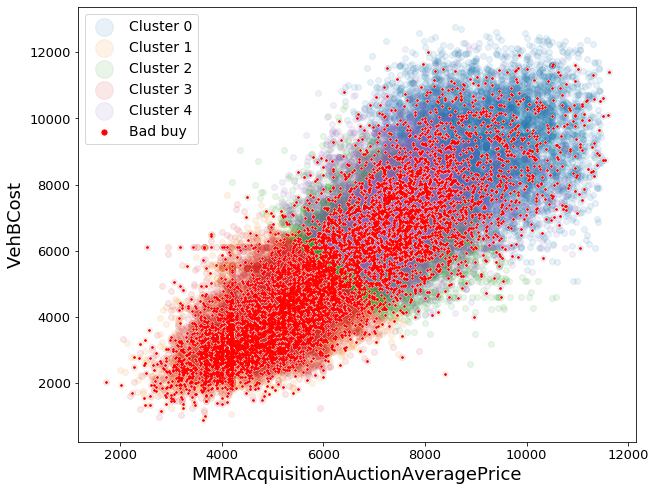

In [41]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [42]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 8830 points
In details: 8097 good buys, and 733 bad buys
So 8.30% of all the points of the cluster 0 are bad buys
This 733 bad buys are 11.06% of all bad buys in the dataset

Cluster 1 has in total 7603 points
In details: 5978 good buys, and 1625 bad buys
So 21.37% of all the points of the cluster 1 are bad buys
This 1625 bad buys are 24.52% of all bad buys in the dataset

Cluster 2 has in total 14766 points
In details: 13396 good buys, and 1370 bad buys
So 9.28% of all the points of the cluster 2 are bad buys
This 1370 bad buys are 20.67% of all bad buys in the dataset

Cluster 3 has in total 13336 points
In details: 11356 good buys, and 1980 bad buys
So 14.85% of all the points of the cluster 3 are bad buys
This 1980 bad buys are 29.87% of all bad buys in the dataset

Cluster 4 has in total 9934 points
In details: 9014 good buys, and 920 bad buys
So 9.26% of all the points of the cluster 4 are bad buys
This 920 bad buys are 13.88% of all bad buys in the dataset

<b>K-means (6 clusters)</b>

In [43]:
num_clusters = 6
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

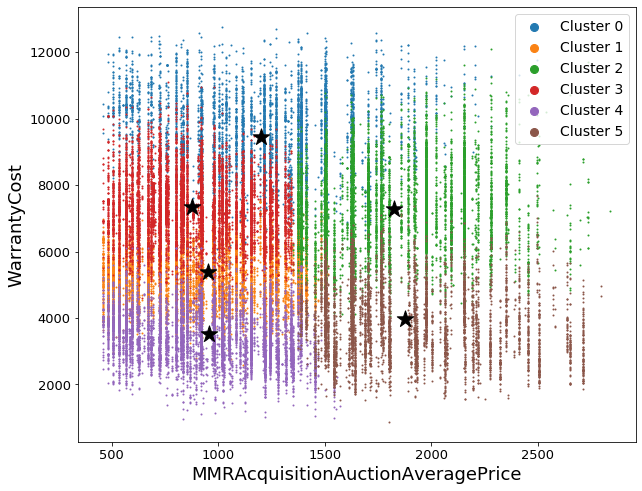

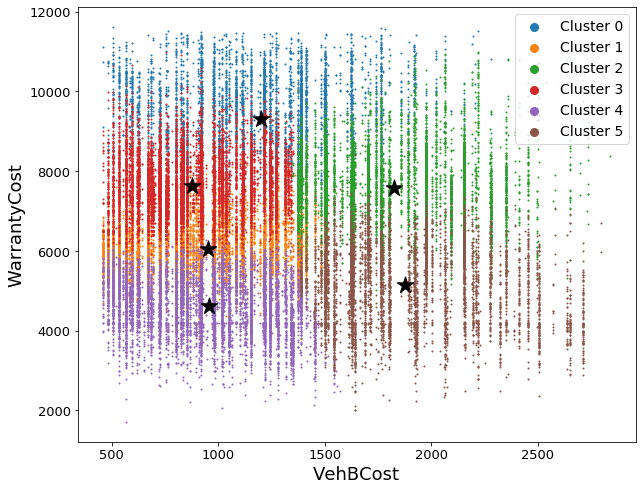

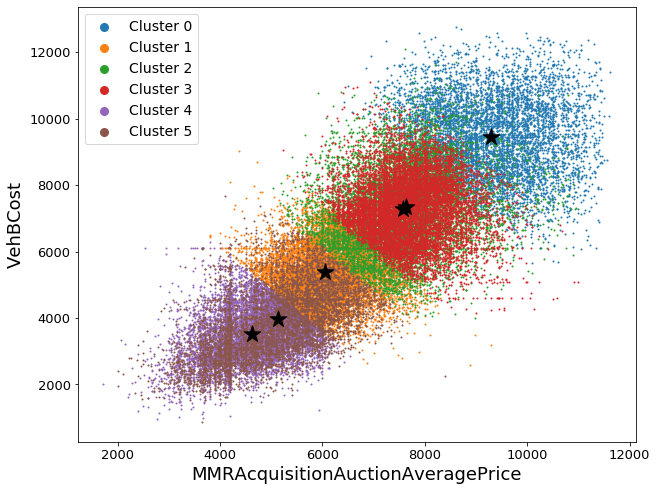

In [44]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 0], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

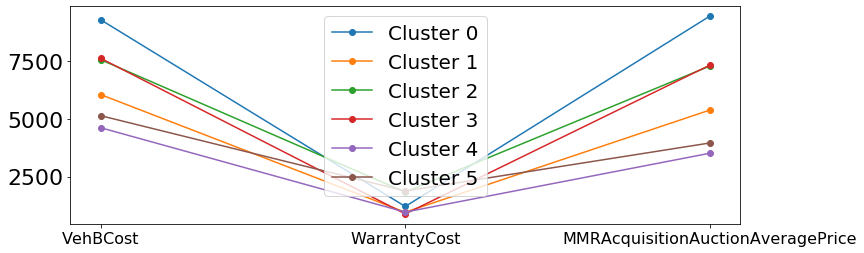

In [45]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(3), ("VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [46]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 40085.44299831085
Silhouette 0.2879614586849094


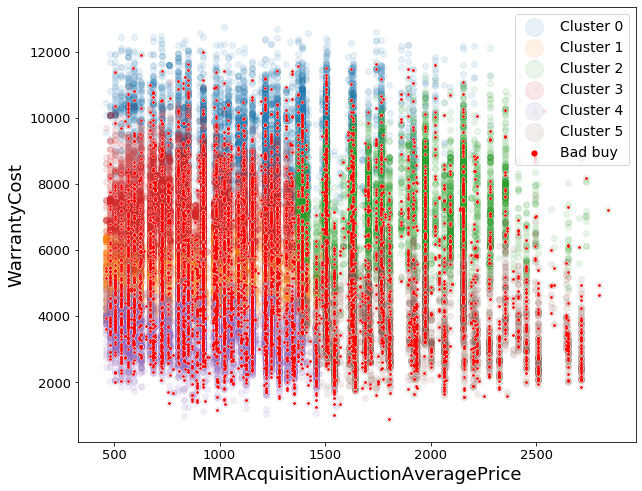

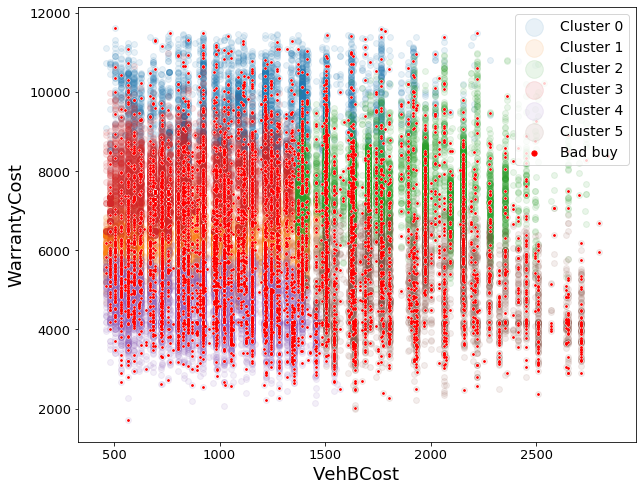

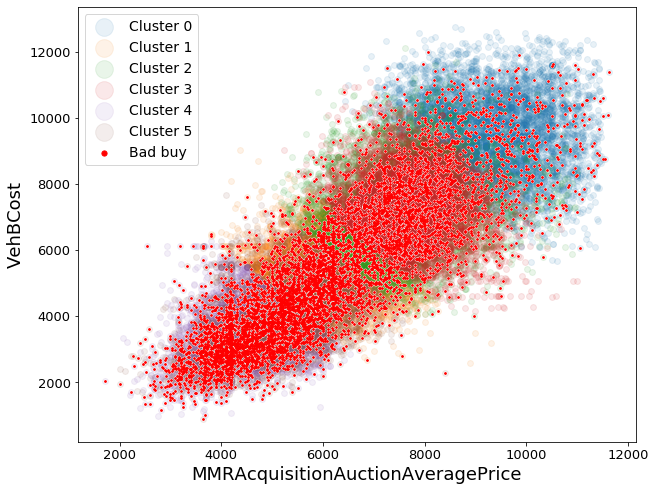

In [47]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [48]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 6634 points
In details: 6057 good buys, and 577 bad buys
So 8.70% of all the points of the cluster 0 are bad buys
This 577 bad buys are 8.71% of all bad buys in the dataset

Cluster 1 has in total 11519 points
In details: 10214 good buys, and 1305 bad buys
So 11.33% of all the points of the cluster 1 are bad buys
This 1305 bad buys are 19.69% of all bad buys in the dataset

Cluster 2 has in total 10121 points
In details: 9188 good buys, and 933 bad buys
So 9.22% of all the points of the cluster 2 are bad buys
This 933 bad buys are 14.08% of all bad buys in the dataset

Cluster 3 has in total 11352 points
In details: 10415 good buys, and 937 bad buys
So 8.25% of all the points of the cluster 3 are bad buys
This 937 bad buys are 14.14% of all bad buys in the dataset

Cluster 4 has in total 8845 points
In details: 7293 good buys, and 1552 bad buys
So 17.55% of all the points of the cluster 4 are bad buys
This 1552 bad buys are 23.42% of all bad buys in the dataset



<b>K-means (7 clusters)</b>

In [49]:
num_clusters = 7
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

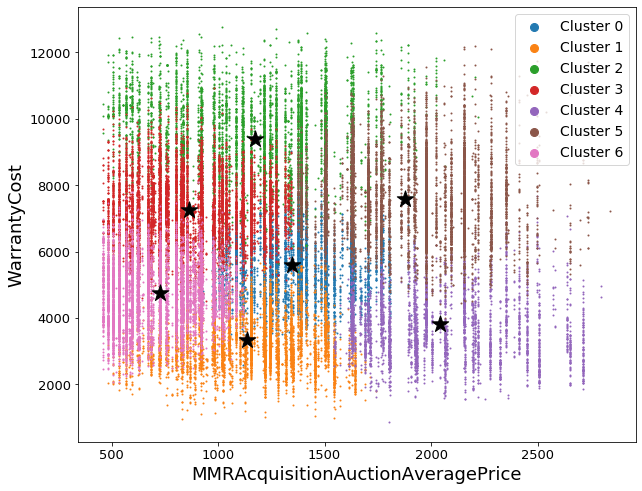

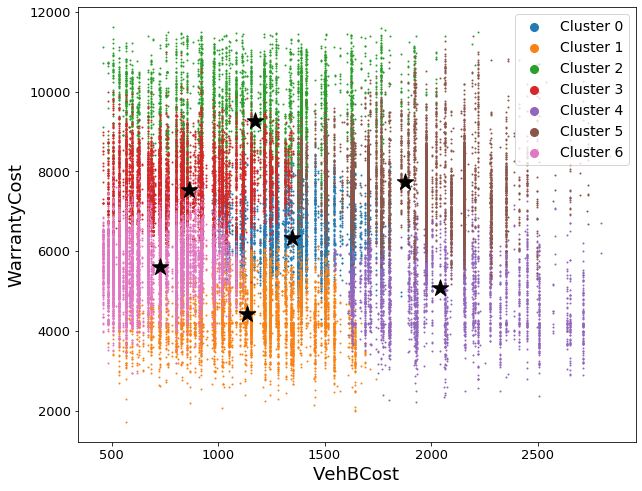

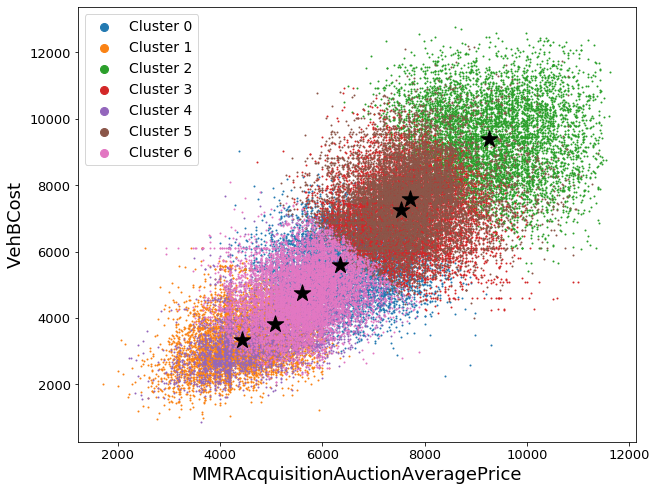

In [50]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 1], centers[:, 0], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 2], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

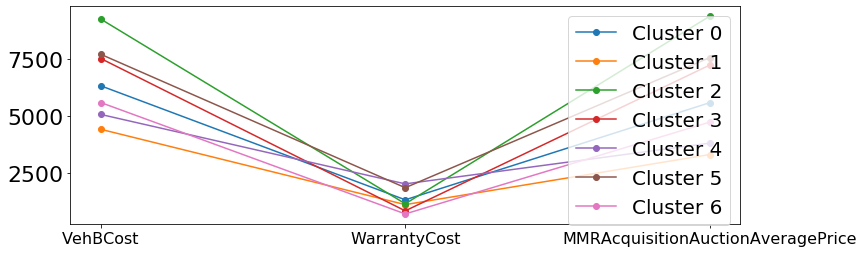

In [51]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(3), ("VehBCost", "WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [52]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 35790.57088745219
Silhouette 0.2959333379032273


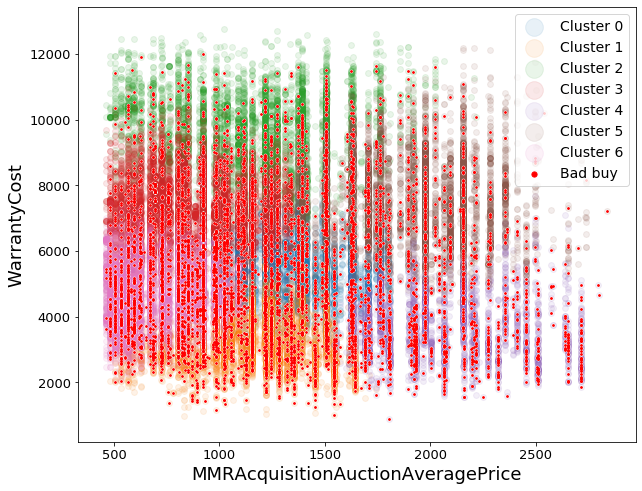

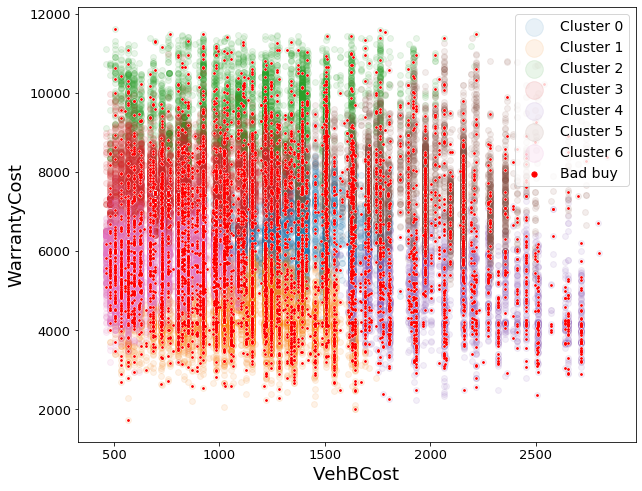

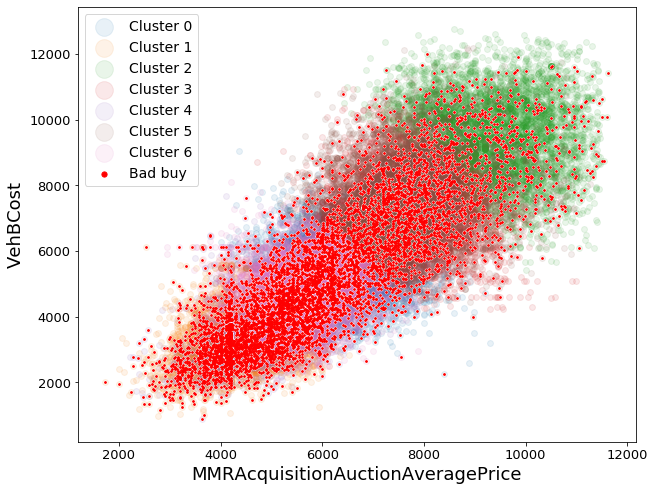

In [53]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [54]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 8200 points
In details: 7262 good buys, and 938 bad buys
So 11.44% of all the points of the cluster 0 are bad buys
This 938 bad buys are 14.15% of all bad buys in the dataset

Cluster 1 has in total 6959 points
In details: 5560 good buys, and 1399 bad buys
So 20.10% of all the points of the cluster 1 are bad buys
This 1399 bad buys are 21.11% of all bad buys in the dataset

Cluster 2 has in total 6838 points
In details: 6247 good buys, and 591 bad buys
So 8.64% of all the points of the cluster 2 are bad buys
This 591 bad buys are 8.92% of all bad buys in the dataset

Cluster 3 has in total 11414 points
In details: 10464 good buys, and 950 bad buys
So 8.32% of all the points of the cluster 3 are bad buys
This 950 bad buys are 14.33% of all bad buys in the dataset

Cluster 4 has in total 3979 points
In details: 3020 good buys, and 959 bad buys
So 24.10% of all the points of the cluster 4 are bad buys
This 959 bad buys are 14.47% of all bad buys in the dataset

Clus

# Graphics with WarrantyCost and MMRAcquisitionAuctionAveragePrice

In [57]:
X = df[["WarrantyCost", "MMRAcquisitionAuctionAveragePrice"]]

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

<b>Graphic for total distance between points and centroids with the change of K</b>

In [54]:
sse_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    sse = kmeans.inertia_
    sse_list.append(sse)

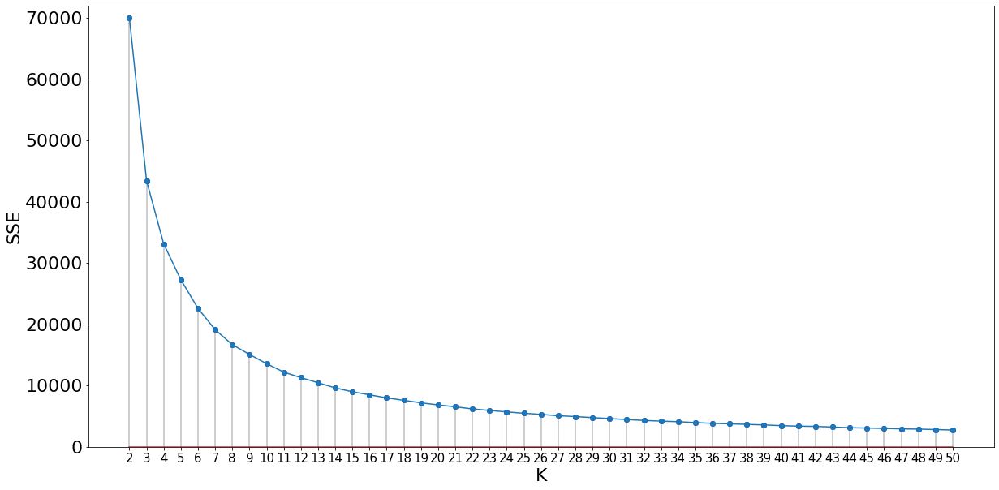

In [55]:
plt.figure(figsize=(20,10))
plt.ylim(0, 72000)
plt.plot(range(2, len(sse_list) + 2), sse_list)
plt.plot(range(2, len(sse_list) + 2), sse_list, 'bo')
plt.stem(range(2, len(sse_list) + 2), sse_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('SSE', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

In [132]:
silhouette_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    silhouette = silhouette_score(X, kmeans.labels_)
    silhouette_list.append(silhouette)

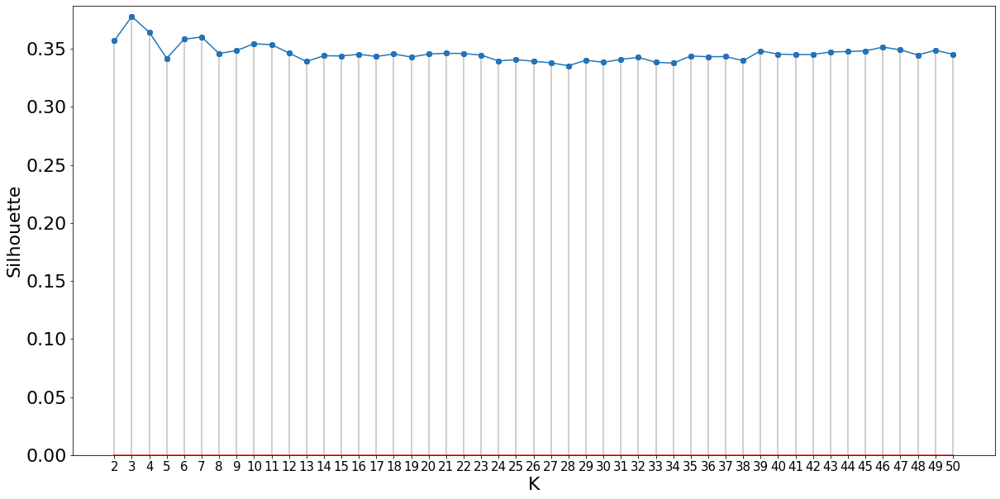

In [133]:
plt.figure(figsize=(20,10))
plt.ylim(0, silhouette_list[0] + 0.03)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list, 'bo')
plt.stem(range(2, len(silhouette_list) + 2), silhouette_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('Silhouette', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

<b>K-means (2 clusters)</b>

In [58]:
num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

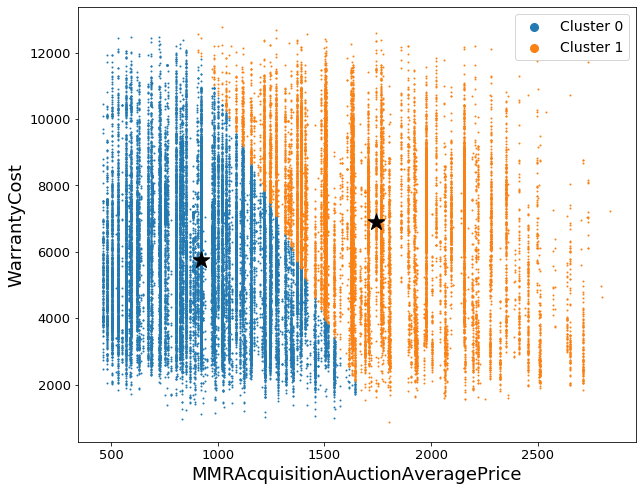

In [60]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

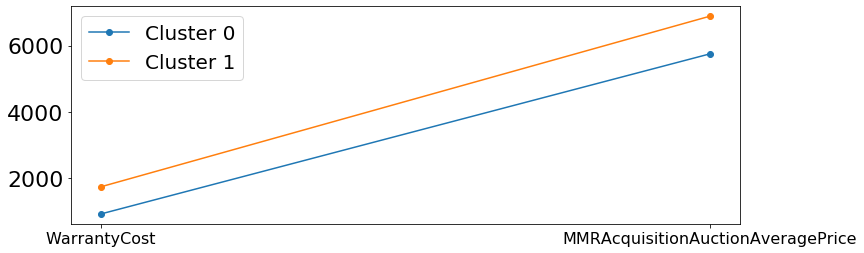

In [62]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [63]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 70041.49913173074
Silhouette 0.3565131654733327


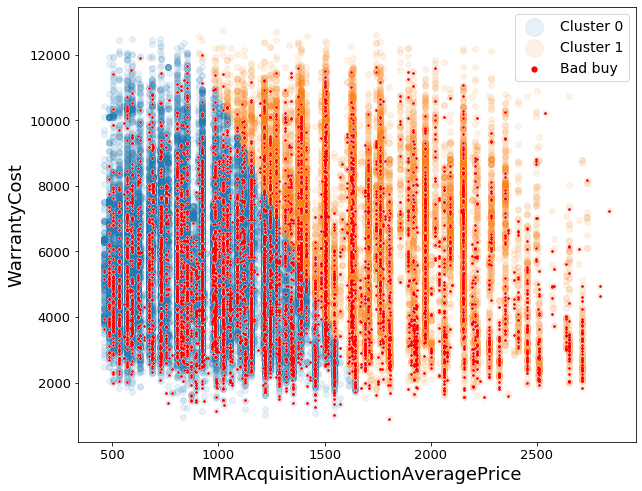

In [64]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [65]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 33720 points
In details: 29702 good buys, and 4018 bad buys
So 11.92% of all the points of the cluster 0 are bad buys
This 4018 bad buys are 60.62% of all bad buys in the dataset

Cluster 1 has in total 20749 points
In details: 18139 good buys, and 2610 bad buys
So 12.58% of all the points of the cluster 1 are bad buys
This 2610 bad buys are 39.38% of all bad buys in the dataset



<b>K-means (3 clusters)</b>

In [70]:
num_clusters = 3
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

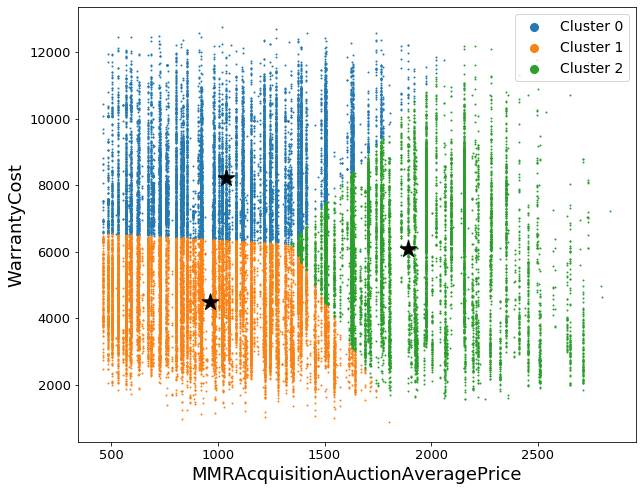

In [71]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

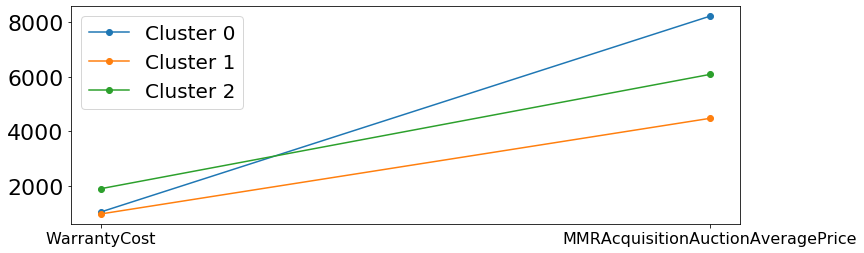

In [72]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [73]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 43472.26573817378
Silhouette 0.37779109007800943


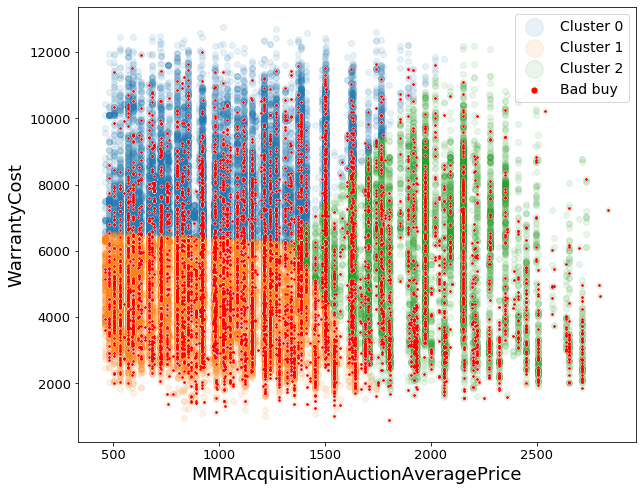

In [74]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [75]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 18581 points
In details: 17076 good buys, and 1505 bad buys
So 8.10% of all the points of the cluster 0 are bad buys
This 1505 bad buys are 22.71% of all bad buys in the dataset

Cluster 1 has in total 21600 points
In details: 18463 good buys, and 3137 bad buys
So 14.52% of all the points of the cluster 1 are bad buys
This 3137 bad buys are 47.33% of all bad buys in the dataset

Cluster 2 has in total 14288 points
In details: 12302 good buys, and 1986 bad buys
So 13.90% of all the points of the cluster 2 are bad buys
This 1986 bad buys are 29.96% of all bad buys in the dataset



<b>K-means (4 clusters)</b>

In [76]:
num_clusters = 4
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

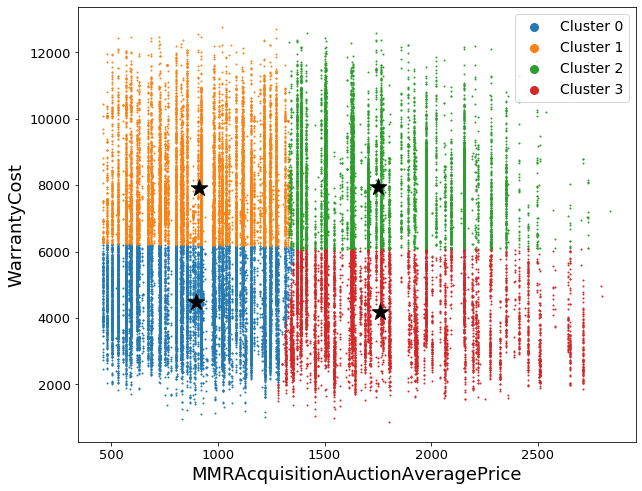

In [77]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

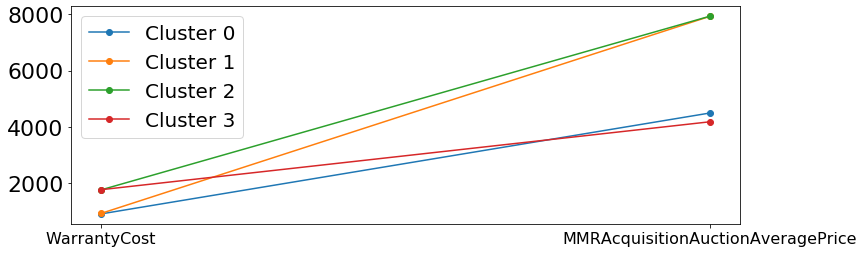

In [79]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [80]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 33139.602670829816
Silhouette 0.3642858783673254


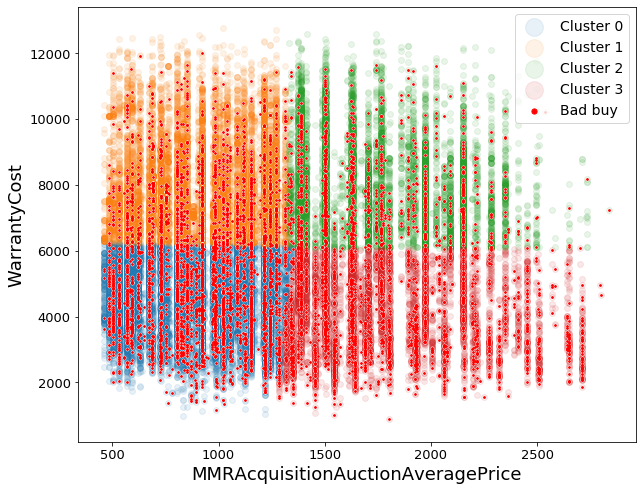

In [81]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [82]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 17809 points
In details: 15319 good buys, and 2490 bad buys
So 13.98% of all the points of the cluster 0 are bad buys
This 2490 bad buys are 37.57% of all bad buys in the dataset

Cluster 1 has in total 15640 points
In details: 14375 good buys, and 1265 bad buys
So 8.09% of all the points of the cluster 1 are bad buys
This 1265 bad buys are 19.09% of all bad buys in the dataset

Cluster 2 has in total 11927 points
In details: 10912 good buys, and 1015 bad buys
So 8.51% of all the points of the cluster 2 are bad buys
This 1015 bad buys are 15.31% of all bad buys in the dataset

Cluster 3 has in total 9093 points
In details: 7235 good buys, and 1858 bad buys
So 20.43% of all the points of the cluster 3 are bad buys
This 1858 bad buys are 28.03% of all bad buys in the dataset



<b>K-means (5 clusters)</b>

In [83]:
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

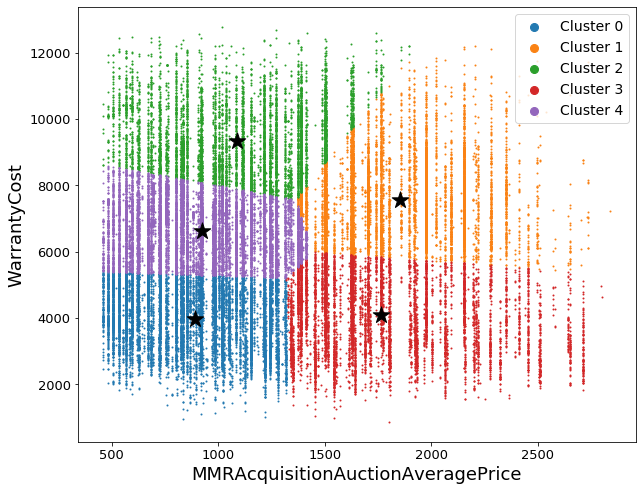

In [84]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

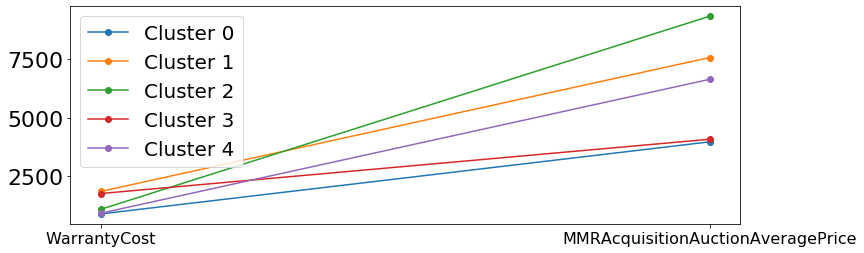

In [85]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [86]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 27288.497657684027
Silhouette 0.3422863543606206


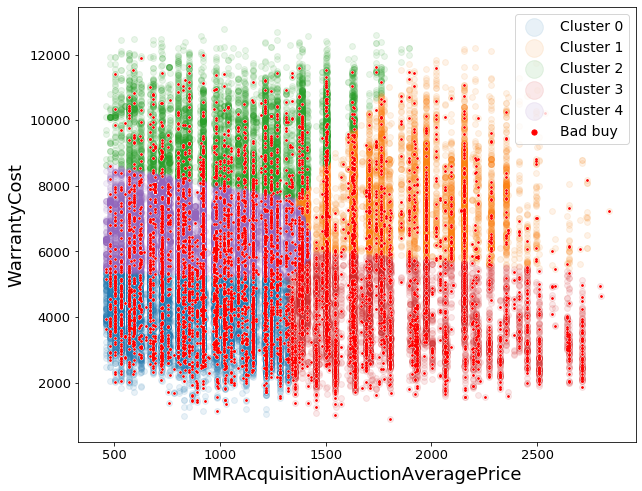

In [87]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [88]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 12855 points
In details: 10896 good buys, and 1959 bad buys
So 15.24% of all the points of the cluster 0 are bad buys
This 1959 bad buys are 29.56% of all bad buys in the dataset

Cluster 1 has in total 9611 points
In details: 8757 good buys, and 854 bad buys
So 8.89% of all the points of the cluster 1 are bad buys
This 854 bad buys are 12.88% of all bad buys in the dataset

Cluster 2 has in total 8060 points
In details: 7420 good buys, and 640 bad buys
So 7.94% of all the points of the cluster 2 are bad buys
This 640 bad buys are 9.66% of all bad buys in the dataset

Cluster 3 has in total 8340 points
In details: 6618 good buys, and 1722 bad buys
So 20.65% of all the points of the cluster 3 are bad buys
This 1722 bad buys are 25.98% of all bad buys in the dataset

Cluster 4 has in total 15603 points
In details: 14150 good buys, and 1453 bad buys
So 9.31% of all the points of the cluster 4 are bad buys
This 1453 bad buys are 21.92% of all bad buys in the dataset


<b>K-means (6 clusters)</b>

In [89]:
num_clusters = 6
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

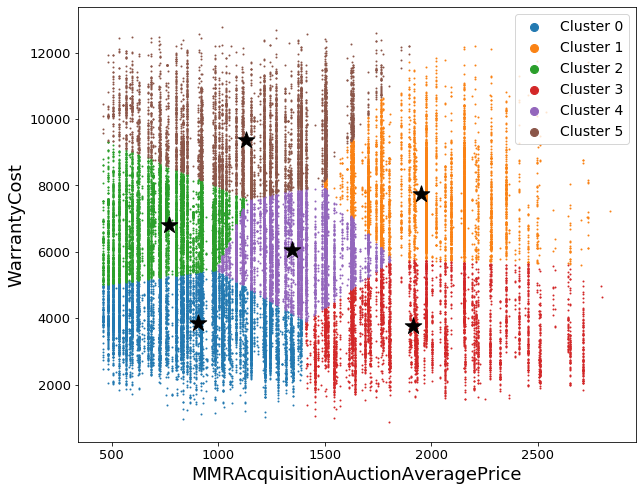

In [90]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

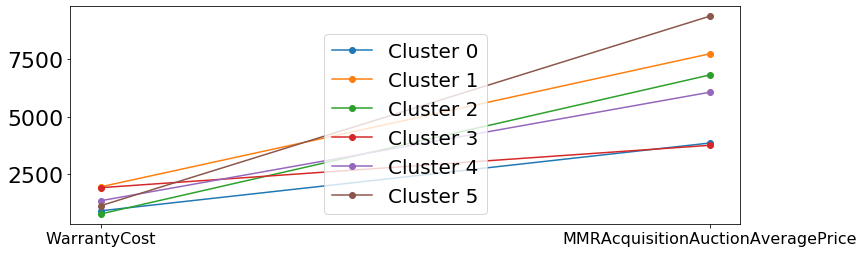

In [91]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [92]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 22606.274988695044
Silhouette 0.35792246051752313


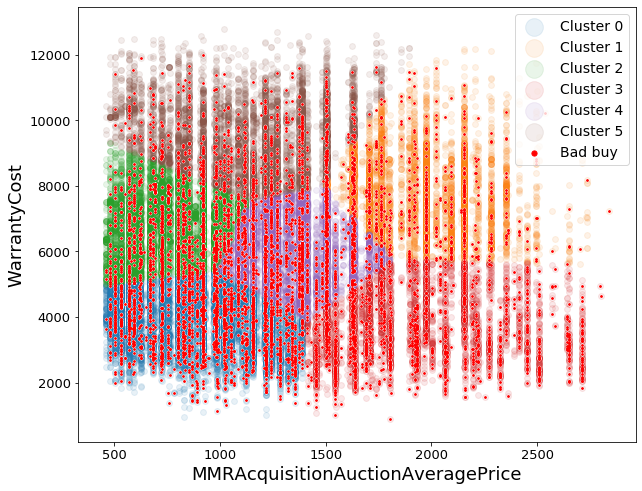

In [93]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [94]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 12383 points
In details: 10418 good buys, and 1965 bad buys
So 15.87% of all the points of the cluster 0 are bad buys
This 1965 bad buys are 29.65% of all bad buys in the dataset

Cluster 1 has in total 7245 points
In details: 6617 good buys, and 628 bad buys
So 8.67% of all the points of the cluster 1 are bad buys
This 628 bad buys are 9.47% of all bad buys in the dataset

Cluster 2 has in total 11504 points
In details: 10539 good buys, and 965 bad buys
So 8.39% of all the points of the cluster 2 are bad buys
This 965 bad buys are 14.56% of all bad buys in the dataset

Cluster 3 has in total 5614 points
In details: 4295 good buys, and 1319 bad buys
So 23.49% of all the points of the cluster 3 are bad buys
This 1319 bad buys are 19.90% of all bad buys in the dataset

Cluster 4 has in total 9863 points
In details: 8762 good buys, and 1101 bad buys
So 11.16% of all the points of the cluster 4 are bad buys
This 1101 bad buys are 16.61% of all bad buys in the dataset

<b>K-means (7 clusters)</b>

In [95]:
num_clusters = 7
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

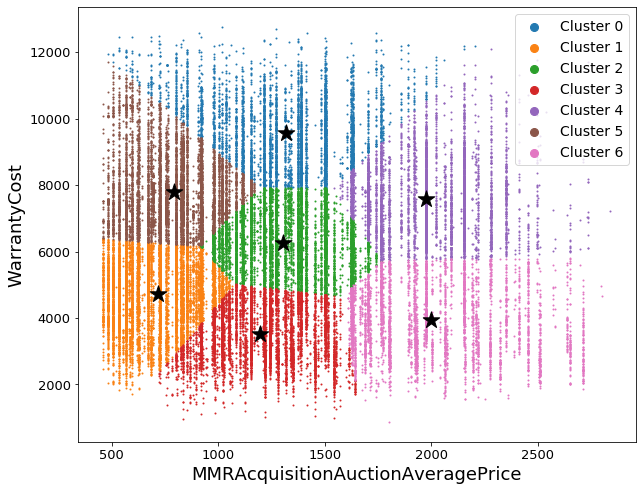

In [96]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

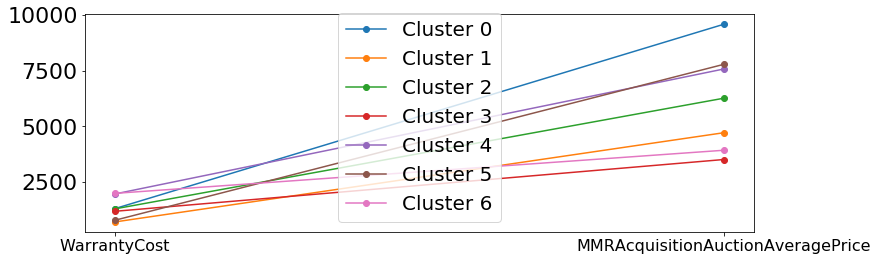

In [97]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [98]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 19133.936494929527
Silhouette 0.36014581306555515


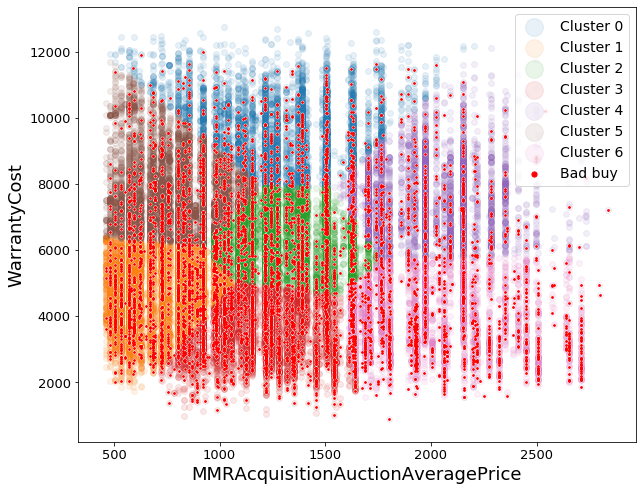

In [99]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [100]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 5688 points
In details: 5203 good buys, and 485 bad buys
So 8.53% of all the points of the cluster 0 are bad buys
This 485 bad buys are 7.32% of all bad buys in the dataset

Cluster 1 has in total 9985 points
In details: 8752 good buys, and 1233 bad buys
So 12.35% of all the points of the cluster 1 are bad buys
This 1233 bad buys are 18.60% of all bad buys in the dataset

Cluster 2 has in total 9863 points
In details: 8772 good buys, and 1091 bad buys
So 11.06% of all the points of the cluster 2 are bad buys
This 1091 bad buys are 16.46% of all bad buys in the dataset

Cluster 3 has in total 7601 points
In details: 6179 good buys, and 1422 bad buys
So 18.71% of all the points of the cluster 3 are bad buys
This 1422 bad buys are 21.45% of all bad buys in the dataset

Cluster 4 has in total 6677 points
In details: 6106 good buys, and 571 bad buys
So 8.55% of all the points of the cluster 4 are bad buys
This 571 bad buys are 8.61% of all bad buys in the dataset

Clu

# Graphics with WarrantyCost and VehBCost

In [101]:
X = df[["WarrantyCost", "VehBCost"]]

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

<b>Graphic for total distance between points and centroids with the change of K</b>

In [57]:
sse_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    sse = kmeans.inertia_
    sse_list.append(sse)

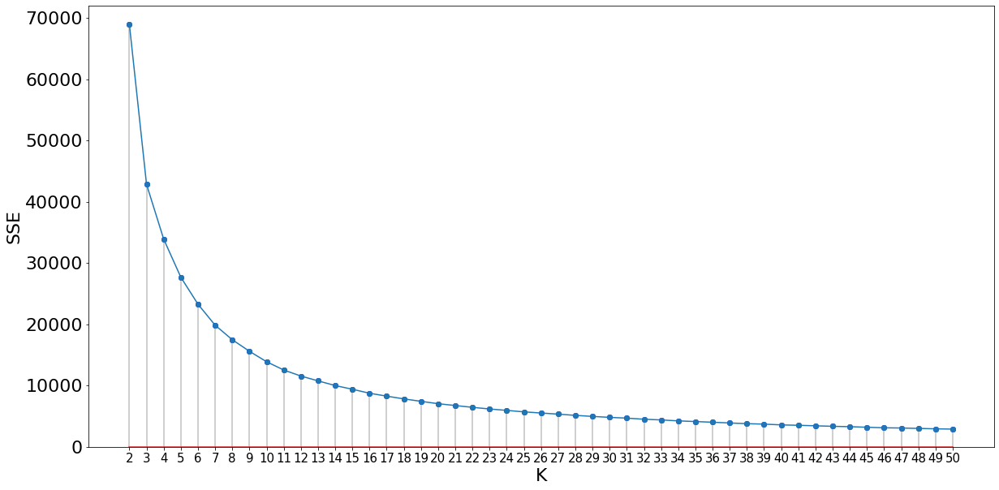

In [58]:
plt.figure(figsize=(20,10))
plt.ylim(0, 72000)
plt.plot(range(2, len(sse_list) + 2), sse_list)
plt.plot(range(2, len(sse_list) + 2), sse_list, 'bo')
plt.stem(range(2, len(sse_list) + 2), sse_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('SSE', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

In [135]:
silhouette_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    silhouette = silhouette_score(X, kmeans.labels_)
    silhouette_list.append(silhouette)

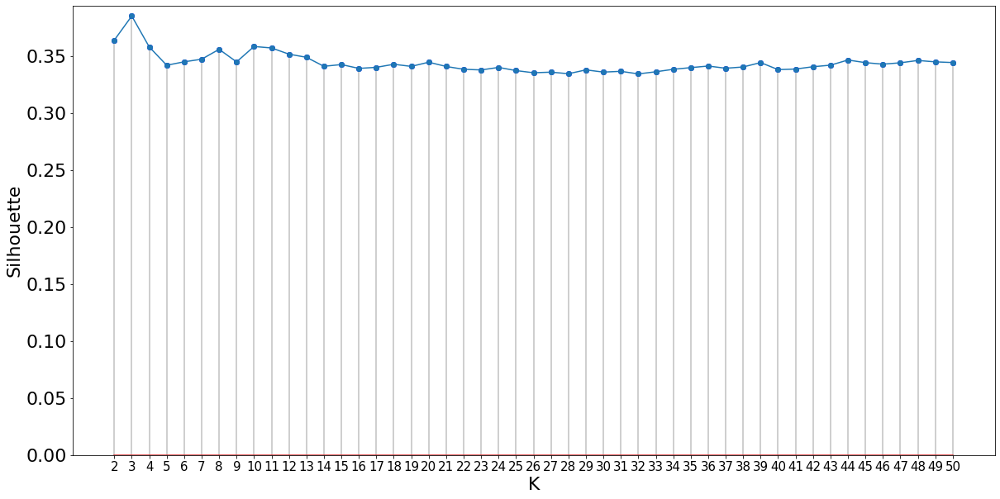

In [136]:
plt.figure(figsize=(20,10))
plt.ylim(0, silhouette_list[0] + 0.03)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list, 'bo')
plt.stem(range(2, len(silhouette_list) + 2), silhouette_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('Silhouette', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

<b>K-means (2 clusters)</b>

In [102]:
num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

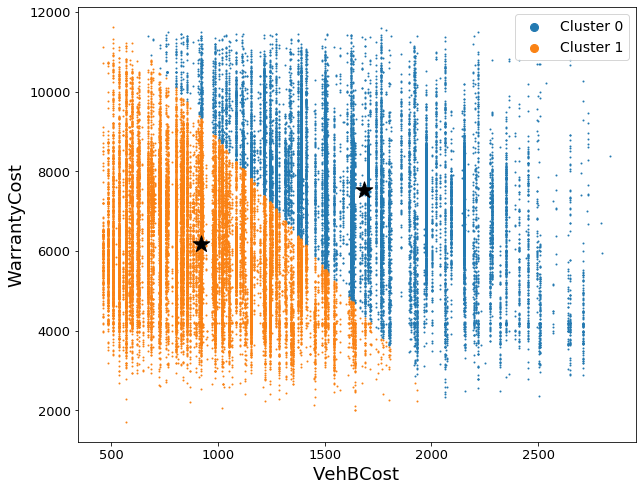

In [103]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

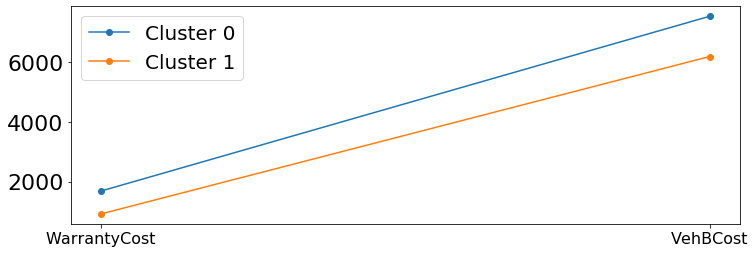

In [104]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [105]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 68982.18761102261
Silhouette 0.36420488681459023


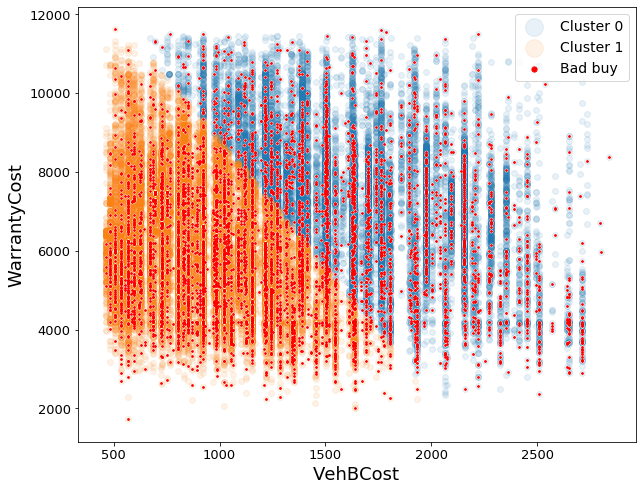

In [106]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [107]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 22209 points
In details: 19508 good buys, and 2701 bad buys
So 12.16% of all the points of the cluster 0 are bad buys
This 2701 bad buys are 40.75% of all bad buys in the dataset

Cluster 1 has in total 32260 points
In details: 28333 good buys, and 3927 bad buys
So 12.17% of all the points of the cluster 1 are bad buys
This 3927 bad buys are 59.25% of all bad buys in the dataset



<b>K-means (3 clusters)</b>

In [108]:
num_clusters = 3
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

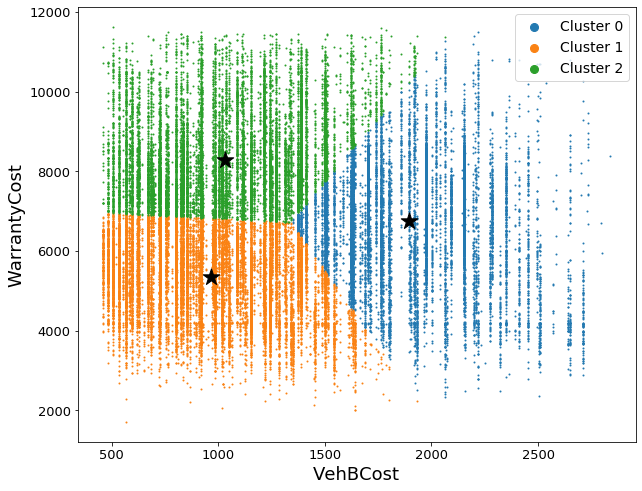

In [109]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

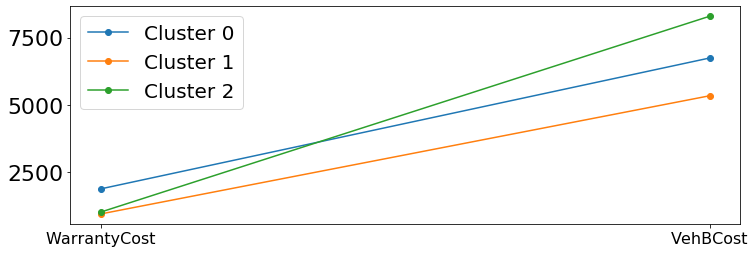

In [110]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [111]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 42857.27072114565
Silhouette 0.3852270179344931


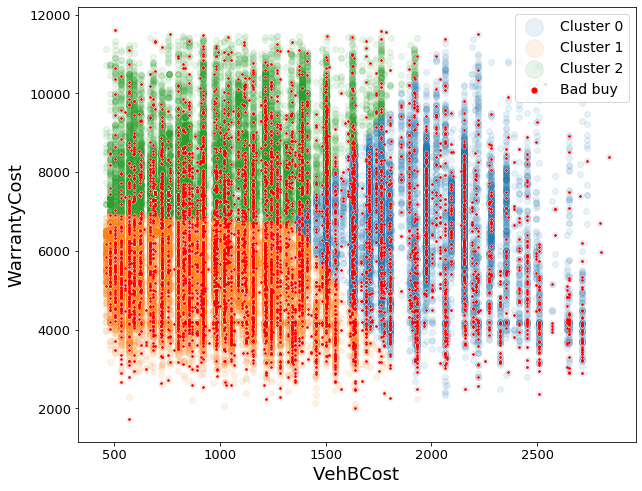

In [112]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [113]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 14300 points
In details: 12379 good buys, and 1921 bad buys
So 13.43% of all the points of the cluster 0 are bad buys
This 1921 bad buys are 28.98% of all bad buys in the dataset

Cluster 1 has in total 21436 points
In details: 18410 good buys, and 3026 bad buys
So 14.12% of all the points of the cluster 1 are bad buys
This 3026 bad buys are 45.65% of all bad buys in the dataset

Cluster 2 has in total 18733 points
In details: 17052 good buys, and 1681 bad buys
So 8.97% of all the points of the cluster 2 are bad buys
This 1681 bad buys are 25.36% of all bad buys in the dataset



<b>K-means (4 clusters)</b>

In [114]:
num_clusters = 4
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

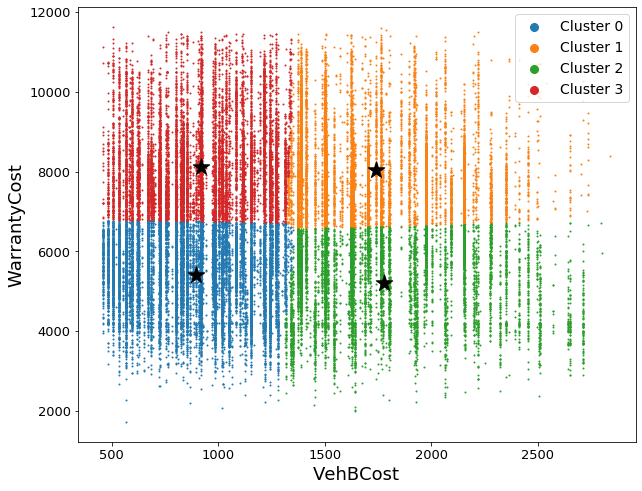

In [115]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

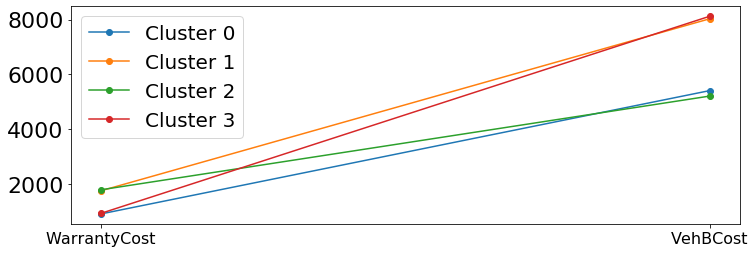

In [116]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [117]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 33889.678563321584
Silhouette 0.3580782493354811


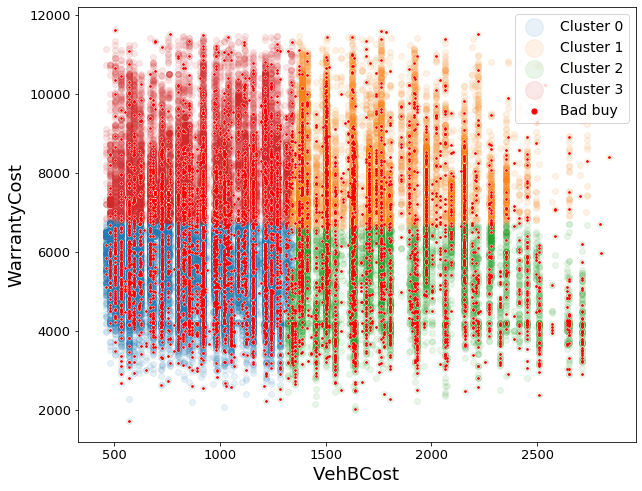

In [118]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [119]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 18169 points
In details: 15751 good buys, and 2418 bad buys
So 13.31% of all the points of the cluster 0 are bad buys
This 2418 bad buys are 36.48% of all bad buys in the dataset

Cluster 1 has in total 12156 points
In details: 11016 good buys, and 1140 bad buys
So 9.38% of all the points of the cluster 1 are bad buys
This 1140 bad buys are 17.20% of all bad buys in the dataset

Cluster 2 has in total 8749 points
In details: 7039 good buys, and 1710 bad buys
So 19.55% of all the points of the cluster 2 are bad buys
This 1710 bad buys are 25.80% of all bad buys in the dataset

Cluster 3 has in total 15395 points
In details: 14035 good buys, and 1360 bad buys
So 8.83% of all the points of the cluster 3 are bad buys
This 1360 bad buys are 20.52% of all bad buys in the dataset



<b>K-means (5 clusters)</b>

In [120]:
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

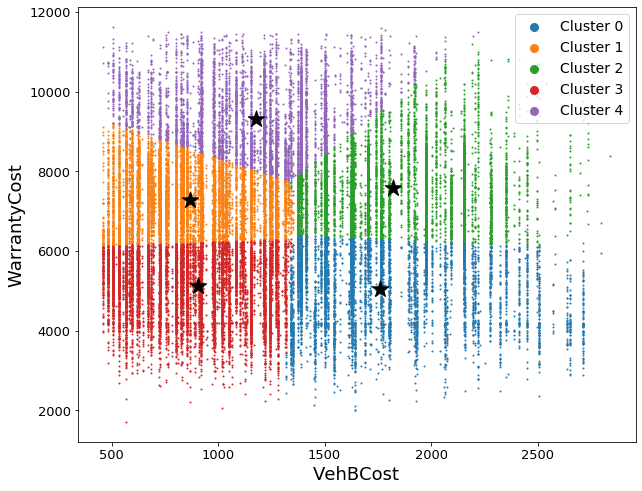

In [121]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

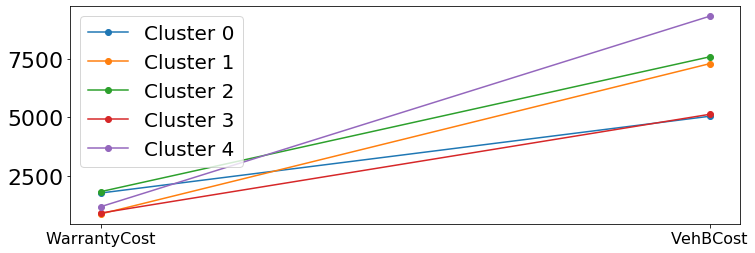

In [122]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [123]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 27686.201314241927
Silhouette 0.3420256517065496


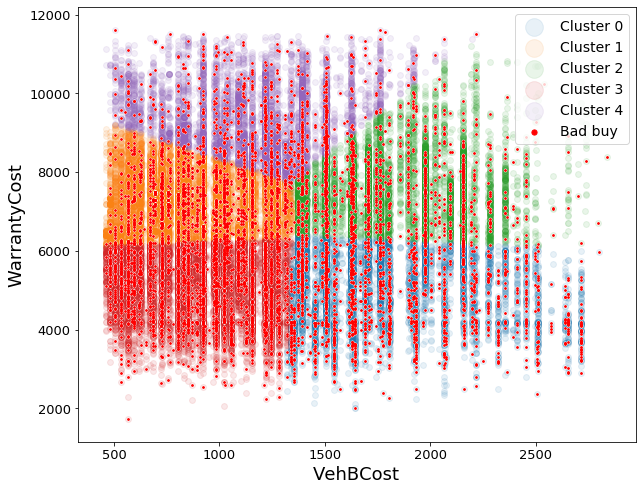

In [124]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [125]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 7669 points
In details: 6087 good buys, and 1582 bad buys
So 20.63% of all the points of the cluster 0 are bad buys
This 1582 bad buys are 23.87% of all bad buys in the dataset

Cluster 1 has in total 14313 points
In details: 13057 good buys, and 1256 bad buys
So 8.78% of all the points of the cluster 1 are bad buys
This 1256 bad buys are 18.95% of all bad buys in the dataset

Cluster 2 has in total 10668 points
In details: 9654 good buys, and 1014 bad buys
So 9.51% of all the points of the cluster 2 are bad buys
This 1014 bad buys are 15.30% of all bad buys in the dataset

Cluster 3 has in total 14486 points
In details: 12407 good buys, and 2079 bad buys
So 14.35% of all the points of the cluster 3 are bad buys
This 2079 bad buys are 31.37% of all bad buys in the dataset

Cluster 4 has in total 7333 points
In details: 6636 good buys, and 697 bad buys
So 9.50% of all the points of the cluster 4 are bad buys
This 697 bad buys are 10.52% of all bad buys in the data

<b>K-means (6 clusters)</b>

In [126]:
num_clusters = 6
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

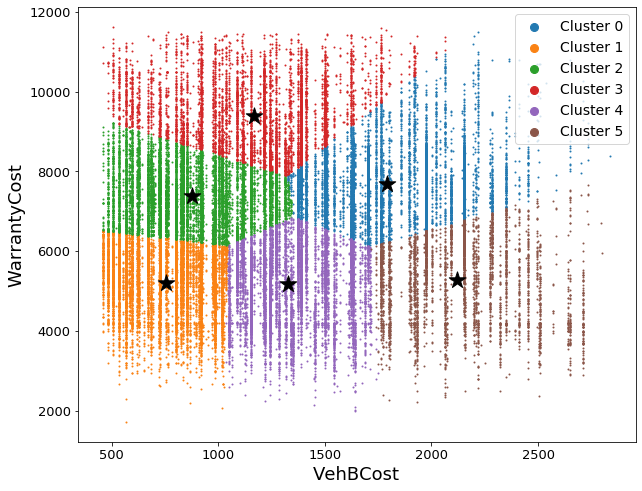

In [127]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

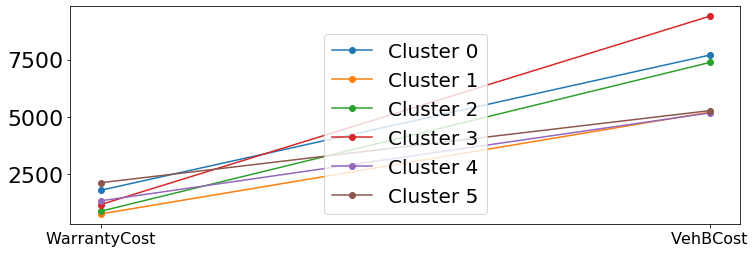

In [128]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [129]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 23284.935028715416
Silhouette 0.344735002059474


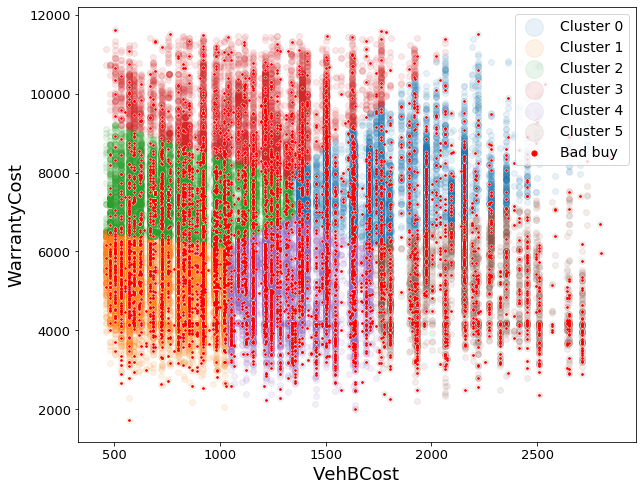

In [130]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [131]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 10180 points
In details: 9219 good buys, and 961 bad buys
So 9.44% of all the points of the cluster 0 are bad buys
This 961 bad buys are 14.50% of all bad buys in the dataset

Cluster 1 has in total 10264 points
In details: 8856 good buys, and 1408 bad buys
So 13.72% of all the points of the cluster 1 are bad buys
This 1408 bad buys are 21.24% of all bad buys in the dataset

Cluster 2 has in total 13594 points
In details: 12423 good buys, and 1171 bad buys
So 8.61% of all the points of the cluster 2 are bad buys
This 1171 bad buys are 17.67% of all bad buys in the dataset

Cluster 3 has in total 6697 points
In details: 6058 good buys, and 639 bad buys
So 9.54% of all the points of the cluster 3 are bad buys
This 639 bad buys are 9.64% of all bad buys in the dataset

Cluster 4 has in total 9764 points
In details: 8203 good buys, and 1561 bad buys
So 15.99% of all the points of the cluster 4 are bad buys
This 1561 bad buys are 23.55% of all bad buys in the dataset


<b>K-means (7 clusters)</b>

In [132]:
num_clusters = 7
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

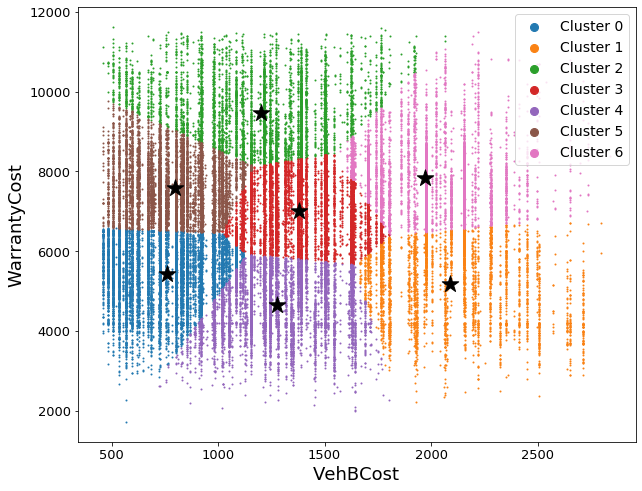

In [133]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

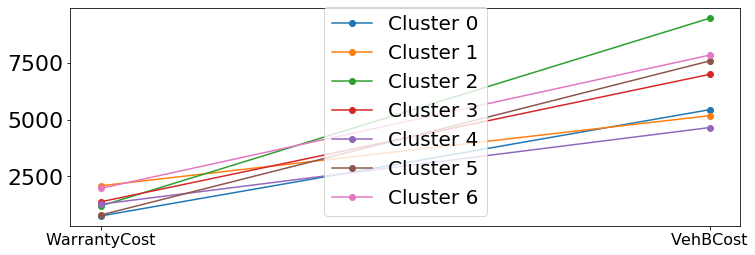

In [134]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [135]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 19858.379270167035
Silhouette 0.34684436361182486


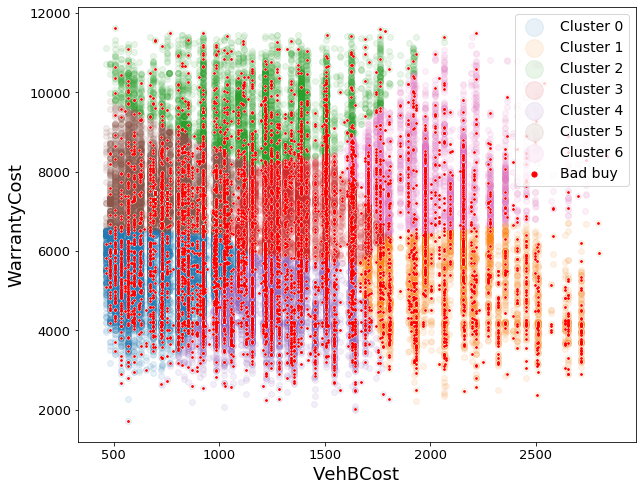

In [136]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [137]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 10788 points
In details: 9447 good buys, and 1341 bad buys
So 12.43% of all the points of the cluster 0 are bad buys
This 1341 bad buys are 20.23% of all bad buys in the dataset

Cluster 1 has in total 3925 points
In details: 3035 good buys, and 890 bad buys
So 22.68% of all the points of the cluster 1 are bad buys
This 890 bad buys are 13.43% of all bad buys in the dataset

Cluster 2 has in total 6131 points
In details: 5524 good buys, and 607 bad buys
So 9.90% of all the points of the cluster 2 are bad buys
This 607 bad buys are 9.16% of all bad buys in the dataset

Cluster 3 has in total 9166 points
In details: 8224 good buys, and 942 bad buys
So 10.28% of all the points of the cluster 3 are bad buys
This 942 bad buys are 14.21% of all bad buys in the dataset

Cluster 4 has in total 7570 points
In details: 6157 good buys, and 1413 bad buys
So 18.67% of all the points of the cluster 4 are bad buys
This 1413 bad buys are 21.32% of all bad buys in the dataset

Cl

<b>K-means (8 clusters)</b>

In [ ]:
num_clusters = 7
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

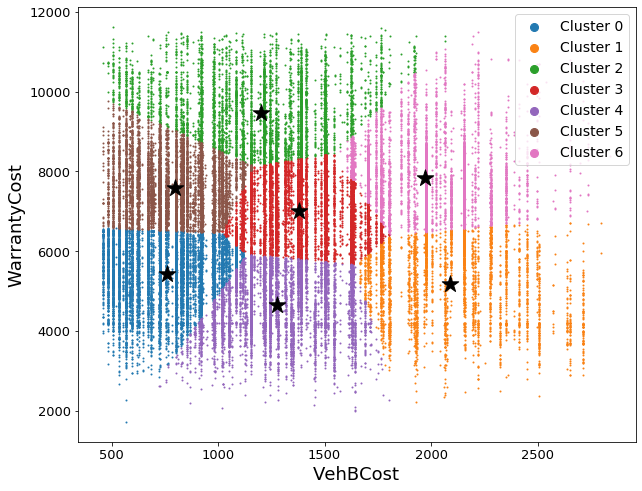

In [138]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 8)
plt.show()

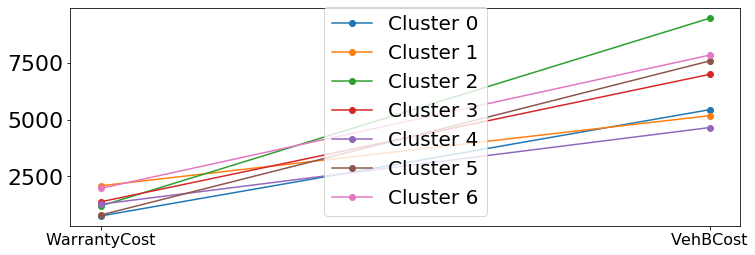

In [139]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("WarrantyCost", "VehBCost"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [140]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 19858.379270167035
Silhouette 0.34684436361182486


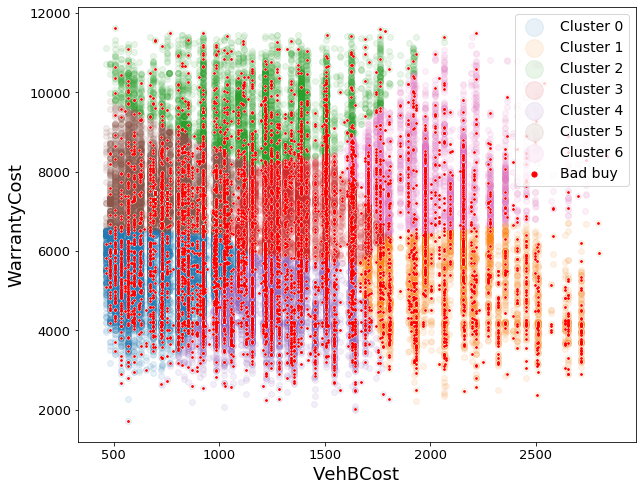

In [141]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['WarrantyCost'], df.iloc[kmean_clusters[i]]['VehBCost'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['WarrantyCost'], df.iloc[isBadBuy_clusters[1]]['VehBCost'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('WarrantyCost', fontsize=18)
plt.xlabel('VehBCost', fontsize=18)
plt.legend(loc="upper right", fontsize = 14, markerscale = 3)
plt.show()

In [142]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 10788 points
In details: 9447 good buys, and 1341 bad buys
So 12.43% of all the points of the cluster 0 are bad buys
This 1341 bad buys are 20.23% of all bad buys in the dataset

Cluster 1 has in total 3925 points
In details: 3035 good buys, and 890 bad buys
So 22.68% of all the points of the cluster 1 are bad buys
This 890 bad buys are 13.43% of all bad buys in the dataset

Cluster 2 has in total 6131 points
In details: 5524 good buys, and 607 bad buys
So 9.90% of all the points of the cluster 2 are bad buys
This 607 bad buys are 9.16% of all bad buys in the dataset

Cluster 3 has in total 9166 points
In details: 8224 good buys, and 942 bad buys
So 10.28% of all the points of the cluster 3 are bad buys
This 942 bad buys are 14.21% of all bad buys in the dataset

Cluster 4 has in total 7570 points
In details: 6157 good buys, and 1413 bad buys
So 18.67% of all the points of the cluster 4 are bad buys
This 1413 bad buys are 21.32% of all bad buys in the dataset

Cl

# Graphics with VehBCost and MMRAcquisitionAuctionAveragePrice 

In [143]:
X = df[["VehBCost", "MMRAcquisitionAuctionAveragePrice"]]

scaler = StandardScaler()
scaler.fit(X)
X = scaler.transform(X)

<b>Graphic for total distance between points and centroids with the change of K</b>

In [60]:
sse_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    sse = kmeans.inertia_
    sse_list.append(sse)

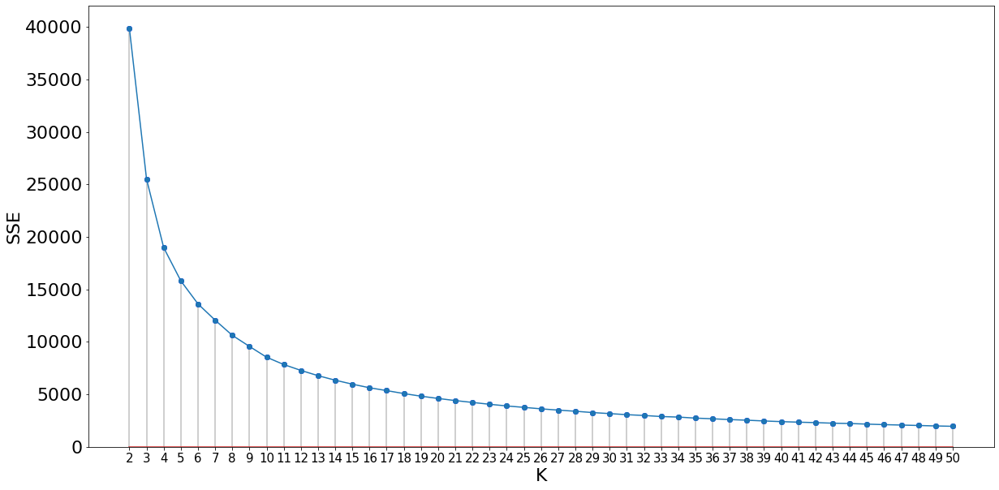

In [62]:
plt.figure(figsize=(20,10))
plt.ylim(0, 42000)
plt.plot(range(2, len(sse_list) + 2), sse_list)
plt.plot(range(2, len(sse_list) + 2), sse_list, 'bo')
plt.stem(range(2, len(sse_list) + 2), sse_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('SSE', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

In [138]:
silhouette_list = list()
max_k = 50
for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, n_init=10, max_iter=100)
    kmeans.fit(X)
    
    silhouette = silhouette_score(X, kmeans.labels_)
    silhouette_list.append(silhouette)

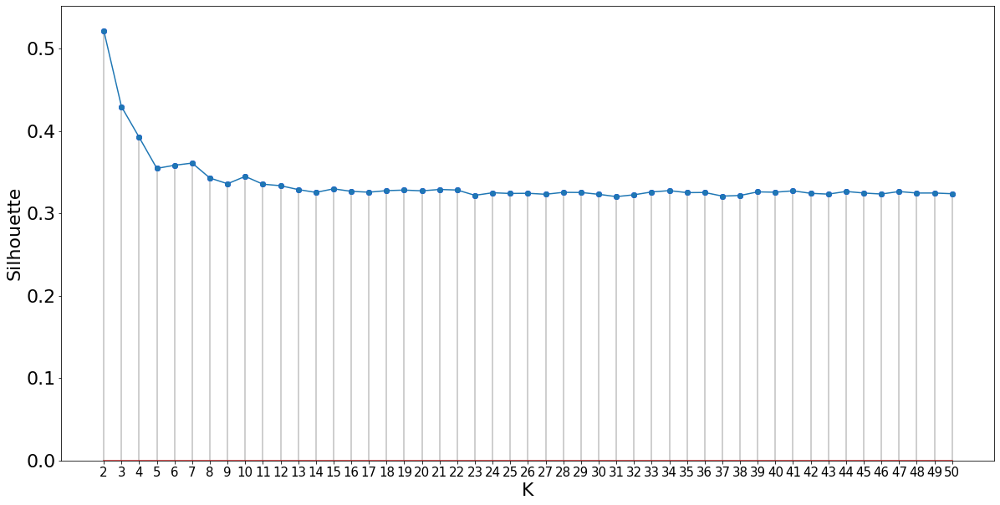

In [139]:
plt.figure(figsize=(20,10))
plt.ylim(0, silhouette_list[0] + 0.03)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list)
plt.plot(range(2, len(silhouette_list) + 2), silhouette_list, 'bo')
plt.stem(range(2, len(silhouette_list) + 2), silhouette_list, '#C0C0C0', use_line_collection=True)
plt.ylabel('Silhouette', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.xticks(np.arange(2, 51, step=1))
plt.tick_params(axis='y', which='both', labelsize=22)
plt.tick_params(axis='x', which='major', labelsize=15)
plt.show()

<b>K-means (2 clusters)</b>

In [144]:
num_clusters = 2
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

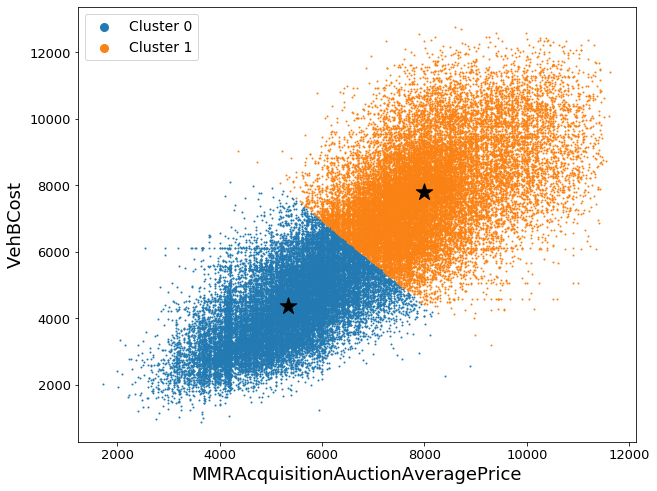

In [145]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

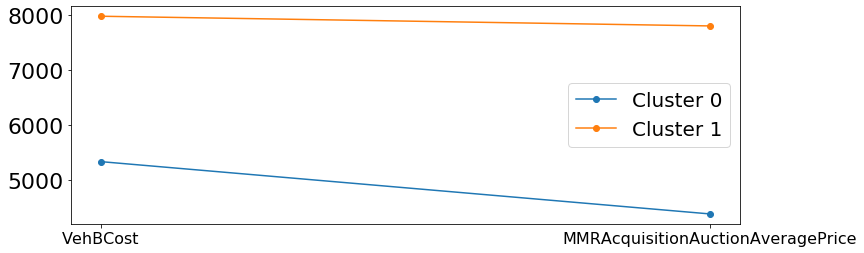

In [146]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("VehBCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [147]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 39866.40345879698
Silhouette 0.5215280741383861


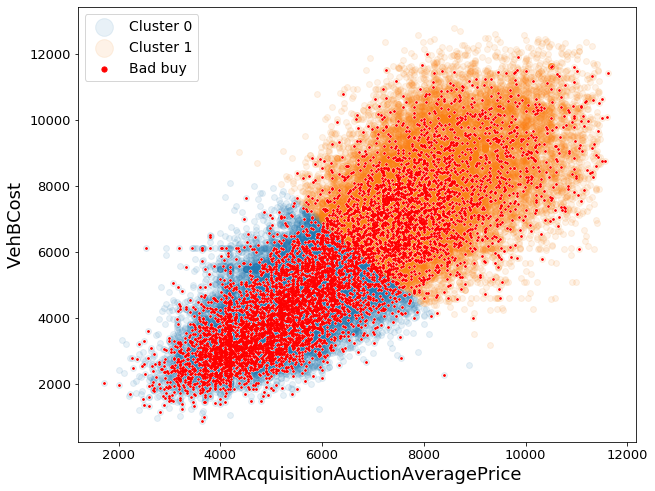

In [148]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [149]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 25948 points
In details: 21774 good buys, and 4174 bad buys
So 16.09% of all the points of the cluster 0 are bad buys
This 4174 bad buys are 62.98% of all bad buys in the dataset

Cluster 1 has in total 28521 points
In details: 26067 good buys, and 2454 bad buys
So 8.60% of all the points of the cluster 1 are bad buys
This 2454 bad buys are 37.02% of all bad buys in the dataset



<b>K-means (3 clusters)</b>

In [150]:
num_clusters = 3
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

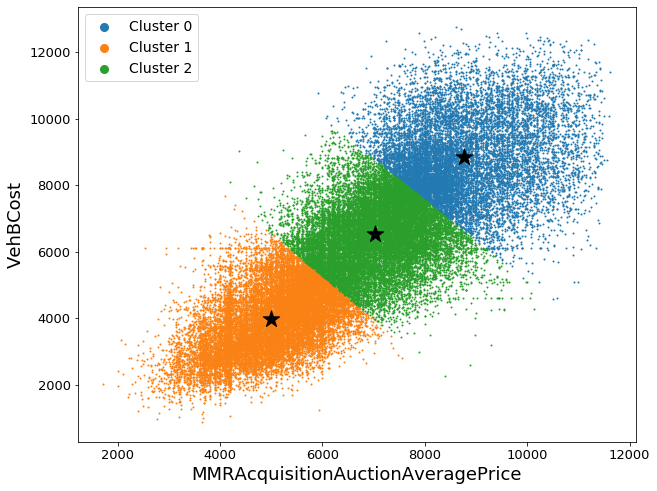

In [151]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

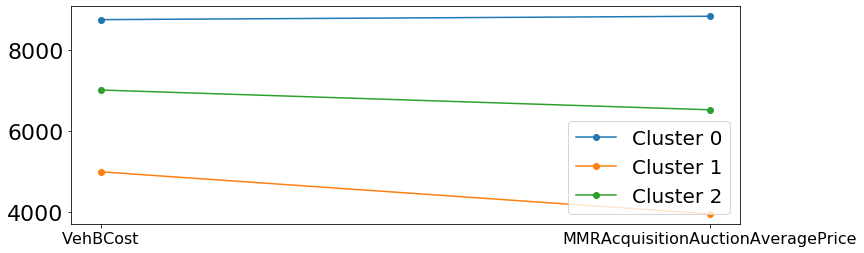

In [154]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("VehBCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [153]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 25505.658776828557
Silhouette 0.4293278323798883


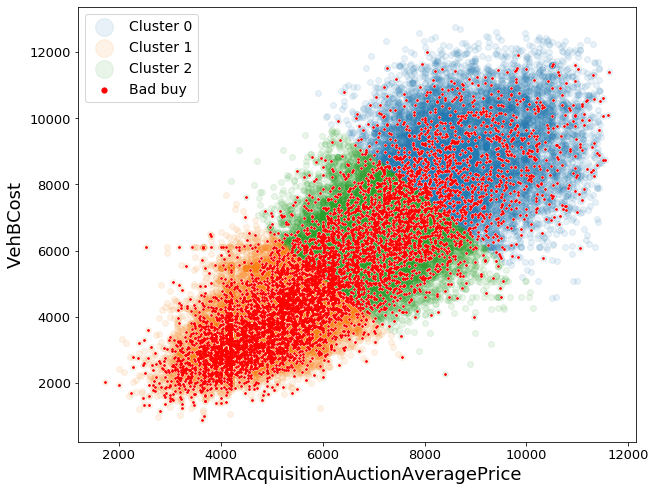

In [155]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [156]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 13346 points
In details: 12233 good buys, and 1113 bad buys
So 8.34% of all the points of the cluster 0 are bad buys
This 1113 bad buys are 16.79% of all bad buys in the dataset

Cluster 1 has in total 19455 points
In details: 16056 good buys, and 3399 bad buys
So 17.47% of all the points of the cluster 1 are bad buys
This 3399 bad buys are 51.28% of all bad buys in the dataset

Cluster 2 has in total 21668 points
In details: 19552 good buys, and 2116 bad buys
So 9.77% of all the points of the cluster 2 are bad buys
This 2116 bad buys are 31.93% of all bad buys in the dataset



<b>K-means (4 clusters)</b>

In [180]:
num_clusters = 4
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

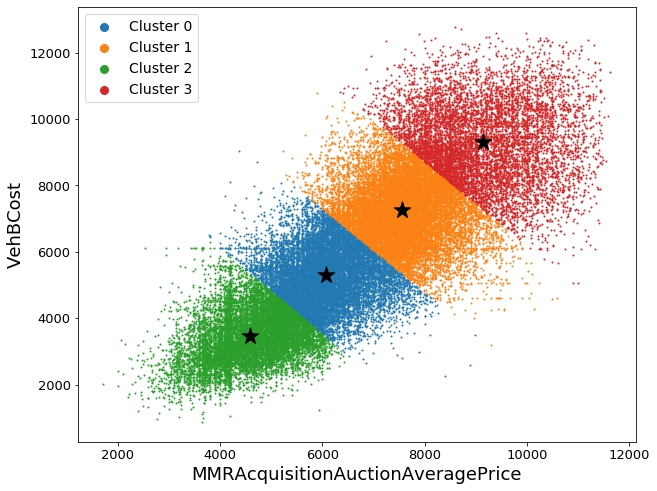

In [181]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

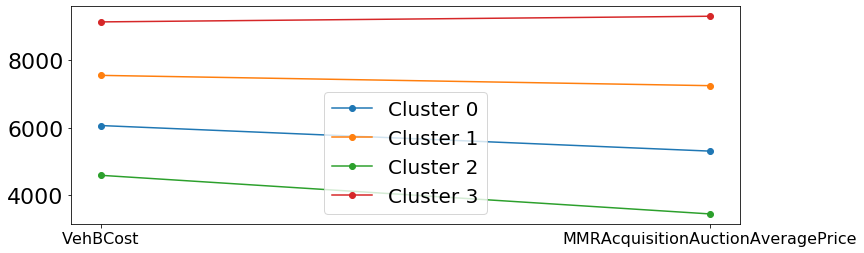

In [182]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("VehBCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [183]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 18969.518603506887
Silhouette 0.39184114413822296


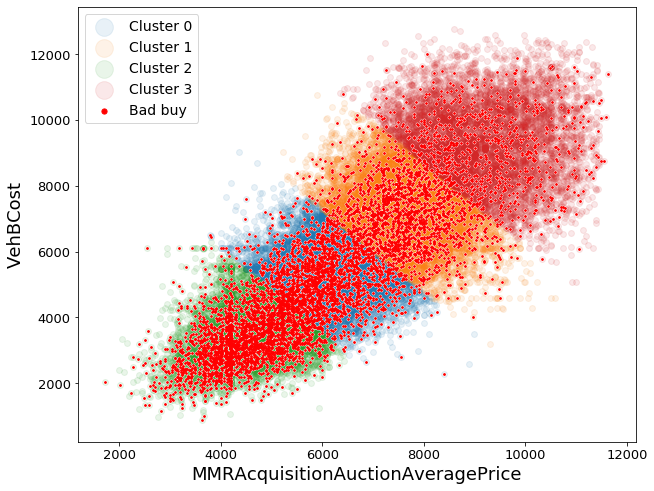

In [184]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [185]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 15321 points
In details: 13452 good buys, and 1869 bad buys
So 12.20% of all the points of the cluster 0 are bad buys
This 1869 bad buys are 28.20% of all bad buys in the dataset

Cluster 1 has in total 18452 points
In details: 16900 good buys, and 1552 bad buys
So 8.41% of all the points of the cluster 1 are bad buys
This 1552 bad buys are 23.42% of all bad buys in the dataset

Cluster 2 has in total 12153 points
In details: 9685 good buys, and 2468 bad buys
So 20.31% of all the points of the cluster 2 are bad buys
This 2468 bad buys are 37.24% of all bad buys in the dataset

Cluster 3 has in total 8543 points
In details: 7804 good buys, and 739 bad buys
So 8.65% of all the points of the cluster 3 are bad buys
This 739 bad buys are 11.15% of all bad buys in the dataset



<b>K-means (5 clusters)</b>

In [162]:
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

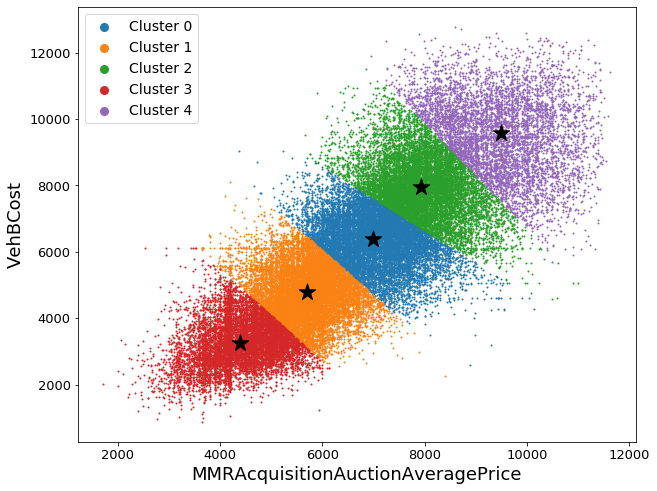

In [163]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

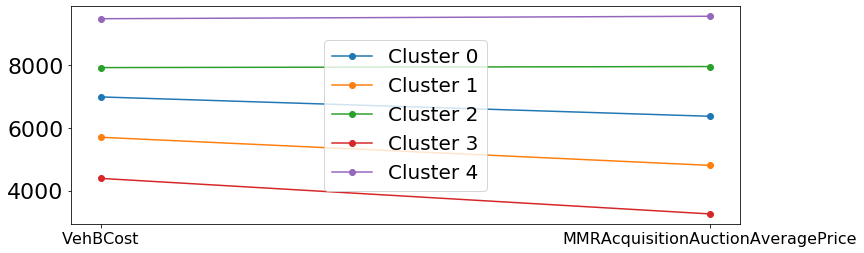

In [164]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("VehBCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [165]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 15807.247154319315
Silhouette 0.3550113854963545


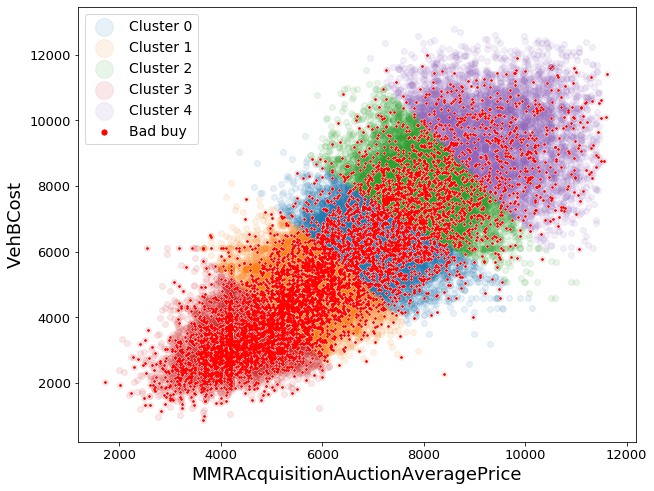

In [166]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [167]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 13321 points
In details: 12029 good buys, and 1292 bad buys
So 9.70% of all the points of the cluster 0 are bad buys
This 1292 bad buys are 19.49% of all bad buys in the dataset

Cluster 1 has in total 13124 points
In details: 11400 good buys, and 1724 bad buys
So 13.14% of all the points of the cluster 1 are bad buys
This 1724 bad buys are 26.01% of all bad buys in the dataset

Cluster 2 has in total 12765 points
In details: 11731 good buys, and 1034 bad buys
So 8.10% of all the points of the cluster 2 are bad buys
This 1034 bad buys are 15.60% of all bad buys in the dataset

Cluster 3 has in total 9353 points
In details: 7298 good buys, and 2055 bad buys
So 21.97% of all the points of the cluster 3 are bad buys
This 2055 bad buys are 31.00% of all bad buys in the dataset

Cluster 4 has in total 5906 points
In details: 5383 good buys, and 523 bad buys
So 8.86% of all the points of the cluster 4 are bad buys
This 523 bad buys are 7.89% of all bad buys in the data

<b>K-means (6 clusters)</b>

In [168]:
num_clusters = 6
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

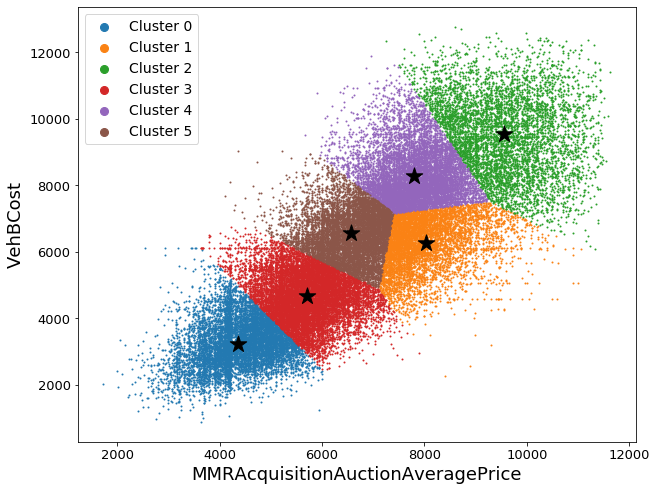

In [169]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

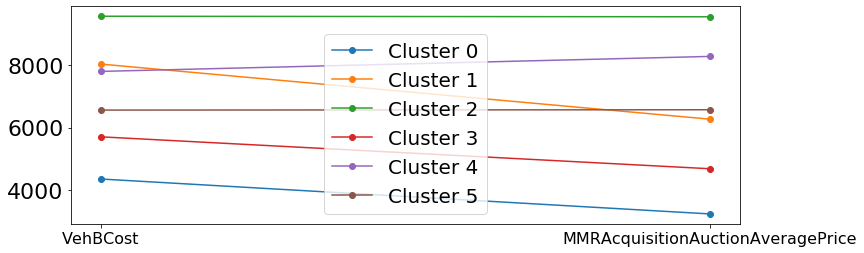

In [170]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("VehBCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [171]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 13613.560390439625
Silhouette 0.3581925167130441


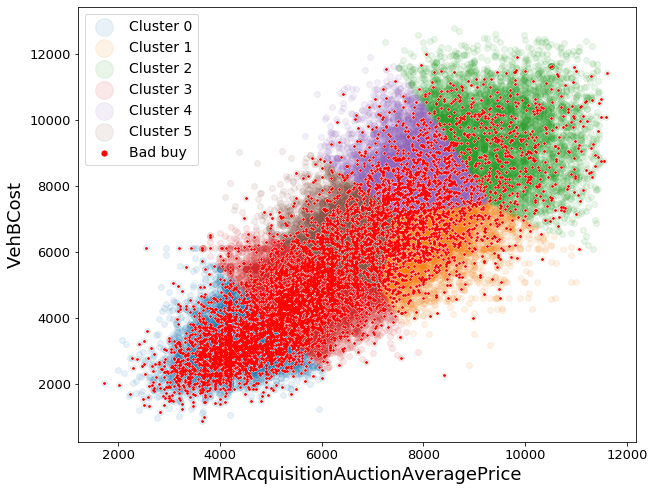

In [172]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [173]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 9094 points
In details: 7083 good buys, and 2011 bad buys
So 22.11% of all the points of the cluster 0 are bad buys
This 2011 bad buys are 30.34% of all bad buys in the dataset

Cluster 1 has in total 6697 points
In details: 5890 good buys, and 807 bad buys
So 12.05% of all the points of the cluster 1 are bad buys
This 807 bad buys are 12.18% of all bad buys in the dataset

Cluster 2 has in total 5668 points
In details: 5161 good buys, and 507 bad buys
So 8.94% of all the points of the cluster 2 are bad buys
This 507 bad buys are 7.65% of all bad buys in the dataset

Cluster 3 has in total 12655 points
In details: 10976 good buys, and 1679 bad buys
So 13.27% of all the points of the cluster 3 are bad buys
This 1679 bad buys are 25.33% of all bad buys in the dataset

Cluster 4 has in total 10500 points
In details: 9773 good buys, and 727 bad buys
So 6.92% of all the points of the cluster 4 are bad buys
This 727 bad buys are 10.97% of all bad buys in the dataset

C

<b>K-means (7 clusters)</b>

In [174]:
num_clusters = 7
kmeans = KMeans(n_clusters=num_clusters, n_init=10, max_iter=100)
kmeans.fit(X)
centers = scaler.inverse_transform(kmeans.cluster_centers_)

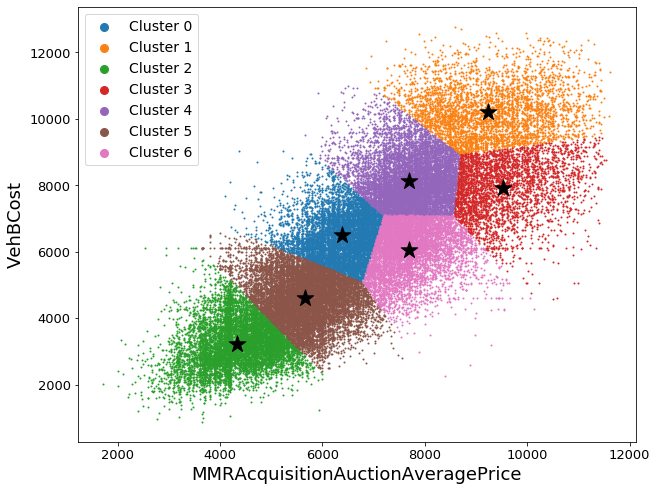

In [175]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=1, label='Cluster %s' % i)
plt.scatter(centers[:, 0], centers[:, 1], s=300, marker='*', c='k')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 8)
plt.show()

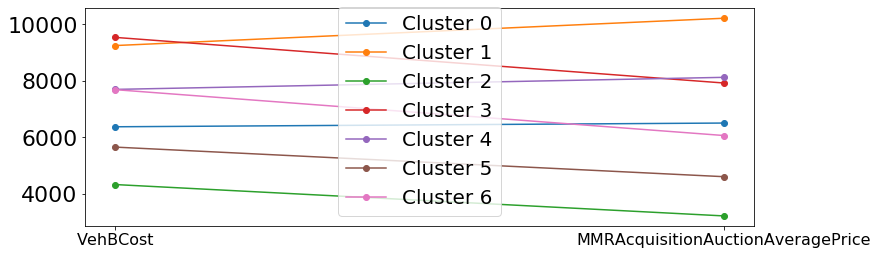

In [176]:
plt.figure(figsize=(12, 4))
for i in range(0, len(centers)):
    plt.plot(centers[i], marker='o', label='Cluster %s' % i)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.xticks(np.arange(2), ("VehBCost", "MMRAcquisitionAuctionAveragePrice"), fontsize=16)
plt.legend(fontsize=20)
plt.show()

In [177]:
print('SSE %s' % kmeans.inertia_)
print('Silhouette %s' % silhouette_score(X, kmeans.labels_))

SSE 12062.440459772624
Silhouette 0.3577849287214899


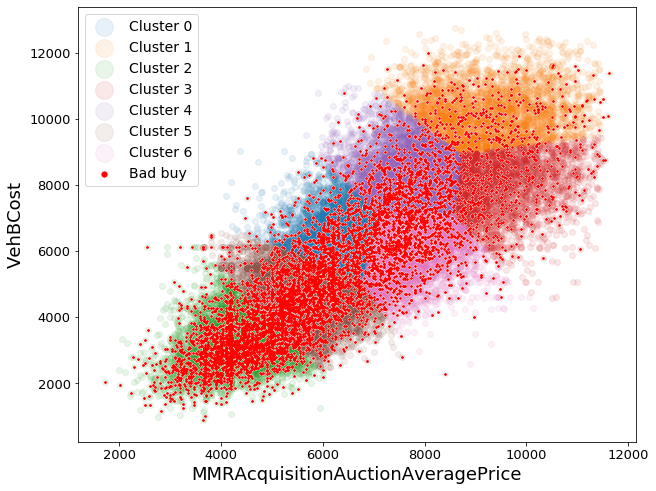

In [178]:
LABEL_COLOR_MAP = {0 : '#2379b1',
                   1 : '#fa8214',
                   2 : '#2b9f2b',
                   3 : '#d32728',
                   4 : '#9366bc',
                   5 : '#8b5649',
                   6 : '#e277c2',
                   7 : '#7f7f7f',
                   8 : '#babd21',
                   9 : '#1dbbcd'
                   }

# Nice Pythonic way to get the indices of the points for each corresponding cluster
kmean_clusters = {i: np.where(kmeans.labels_ == i)[0] for i in range(kmeans.n_clusters)}
isBadBuy_clusters = {i: np.where(df["IsBadBuy"] == i)[0] for i in range(2)}

plt.figure(figsize=(10, 8))
for i in kmean_clusters.keys():
    plt.scatter(df.iloc[kmean_clusters[i]]['VehBCost'], df.iloc[kmean_clusters[i]]['MMRAcquisitionAuctionAveragePrice'], c=LABEL_COLOR_MAP[i], s=35, alpha=0.1, label='Cluster %s' % i)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='w', s=7)
plt.scatter(df.iloc[isBadBuy_clusters[1]]['VehBCost'], df.iloc[isBadBuy_clusters[1]]['MMRAcquisitionAuctionAveragePrice'], c='r', s=3, label='Bad buy')
plt.tick_params(axis='both', which='major', labelsize=13)
plt.ylabel('VehBCost', fontsize=18)
plt.xlabel('MMRAcquisitionAuctionAveragePrice', fontsize=18)
plt.legend(loc="upper left", fontsize = 14, markerscale = 3)
plt.show()

In [179]:
numBadBuy = df["IsBadBuy"].value_counts()[1]
for i in range(num_clusters):
    absolute_values = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()
    num_values = absolute_values[0] + absolute_values[1]
    percentage = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts(normalize=True)
    percentage_of_bad_buys = df.iloc[kmean_clusters[i]]["IsBadBuy"].value_counts()[1]*1.0 / numBadBuy
    print("Cluster " + str(i) + " has in total " + str(num_values) + " points")
    print("In details: " + str(absolute_values[0]) + " good buys, and " + str(absolute_values[1]) + " bad buys")
    print("So " + str("%.2f" % (percentage[1] * 100)) + "% of all the points of the cluster " + str(i) + " are bad buys")
    print("This " + str(absolute_values[1]) + " bad buys are " + str("%.2f" % (percentage_of_bad_buys*100)) + "% of all bad buys in the dataset")
    print()

Cluster 0 has in total 8445 points
In details: 7661 good buys, and 784 bad buys
So 9.28% of all the points of the cluster 0 are bad buys
This 784 bad buys are 11.83% of all bad buys in the dataset

Cluster 1 has in total 4005 points
In details: 3688 good buys, and 317 bad buys
So 7.92% of all the points of the cluster 1 are bad buys
This 317 bad buys are 4.78% of all bad buys in the dataset

Cluster 2 has in total 8763 points
In details: 6805 good buys, and 1958 bad buys
So 22.34% of all the points of the cluster 2 are bad buys
This 1958 bad buys are 29.54% of all bad buys in the dataset

Cluster 3 has in total 3432 points
In details: 3053 good buys, and 379 bad buys
So 11.04% of all the points of the cluster 3 are bad buys
This 379 bad buys are 5.72% of all bad buys in the dataset

Cluster 4 has in total 10700 points
In details: 9947 good buys, and 753 bad buys
So 7.04% of all the points of the cluster 4 are bad buys
This 753 bad buys are 11.36% of all bad buys in the dataset

Cluster